# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

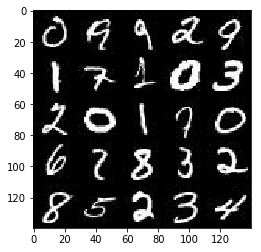

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

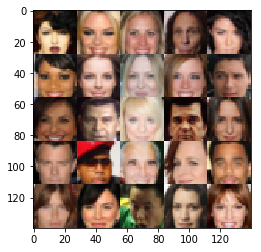

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [6]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    """
    Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks
    Paper: https://arxiv.org/abs/1511.06434
    Example: https://github.com/carpedm20/DCGAN-tensorflow
    """
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Hidden layer
        h1 = tf.layers.conv2d(images, 64, 5, 2, 'same')
        # Leaky ReLU
        h1 = tf.maximum(alpha * h1, h1)
        
        h2 = tf.layers.conv2d(h1, 128, 5, 2, 'same')
        h2 = tf.layers.batch_normalization(h2, training=True)
        h2 = tf.maximum(alpha * h2, h2)
        
        h3 = tf.layers.conv2d(h2, 256, 5, 1, 'same')
        h3 = tf.layers.batch_normalization(h3, training=True)
        h3 = tf.maximum(alpha * h3, h3)
        
        h4 = tf.layers.conv2d(h3, 512, 5, 1, 'same')
        h4 = tf.layers.batch_normalization(h4, training=True)
        h4 = tf.maximum(alpha * h4, h4)
        
        flat = tf.reshape(h4, (-1, 7*7*512))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    with tf.variable_scope('generator', reuse=not is_train):
        
        h1 = tf.layers.dense(z, 7*7*512)
        h1 = tf.reshape(h1, (-1, 7, 7, 512))
        h1 = tf.maximum(alpha * h1, h1)
    
        h2 = tf.layers.conv2d_transpose(h1, 256, 3, 1, 'same')
        h2 = tf.layers.batch_normalization(h2, training=is_train)
        h2 = tf.maximum(alpha * h2, h2)
    
        h3 = tf.layers.conv2d_transpose(h2, 128, 3, 1, 'same')
        h3 = tf.layers.batch_normalization(h3, training=is_train)
        h3 = tf.maximum(alpha * h3, h3)
        
        h4 = tf.layers.conv2d_transpose(h3, 64, 3, 2, 'same')
        h4 = tf.layers.batch_normalization(h4, training=is_train)
        h4 = tf.maximum(alpha * h4, h4)
    
        # Logits and tanh output
        logits = tf.layers.conv2d_transpose(h4, out_channel_dim, 3, 2, 'same')
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    smooth = 0.1
    
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                                 (logits=d_logits_real, 
                                  labels=tf.ones_like(d_model_real) * (1 - smooth)))

    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                                 (logits=d_logits_fake, 
                                  labels=tf.zeros_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                            (logits=d_logits_fake, 
                             labels=tf.ones_like(d_model_fake)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    # Get the trainable_variables, split into G and D parts
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]

    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    
    assign_op  = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    concat  = [assign_op for assign_op in assign_op if assign_op.name.startswith('generator')]
    
    with tf.control_dependencies(concat ):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1).minimize(g_loss, var_list=g_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    input_real, input_z, _ = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    step_count = 0
    step_print = 10
    step_example = 100
    losses = []
    show_n_images = 25
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                
                # Get images
                step_count += 1
                batch_images = batch_images * 2
                
                 # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z})
                
                if step_count % step_print == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                        "Discriminator Loss: {:.4f}...".format(train_loss_d),
                        "Generator Loss: {:.4f}".format(train_loss_g))    
                    
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                    
                    show_generator_output(sess, show_n_images, input_z, data_shape[3], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 3.6770... Generator Loss: 0.1870


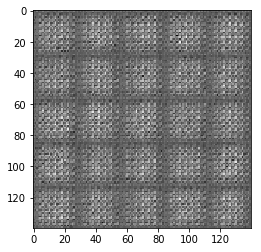

Epoch 1/2... Discriminator Loss: 1.1693... Generator Loss: 10.7039


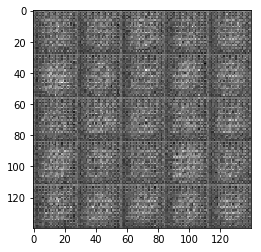

Epoch 1/2... Discriminator Loss: 0.4893... Generator Loss: 7.1367


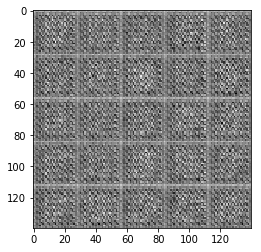

Epoch 1/2... Discriminator Loss: 0.4338... Generator Loss: 3.2043


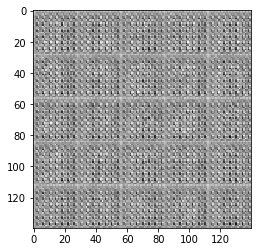

Epoch 1/2... Discriminator Loss: 1.0865... Generator Loss: 4.3418


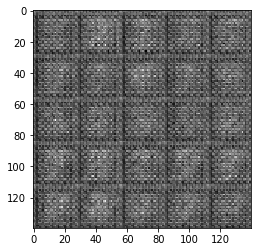

Epoch 1/2... Discriminator Loss: 1.9370... Generator Loss: 1.6446


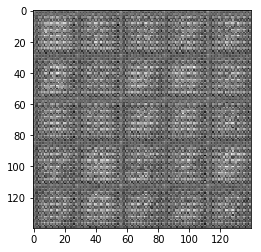

Epoch 1/2... Discriminator Loss: 2.1195... Generator Loss: 0.9848


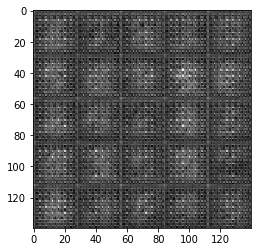

Epoch 1/2... Discriminator Loss: 4.4968... Generator Loss: 12.6594


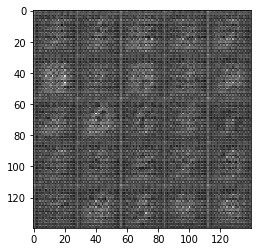

Epoch 1/2... Discriminator Loss: 4.5547... Generator Loss: 0.0332


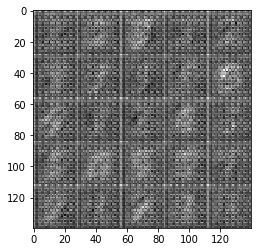

Epoch 1/2... Discriminator Loss: 2.1300... Generator Loss: 0.4174


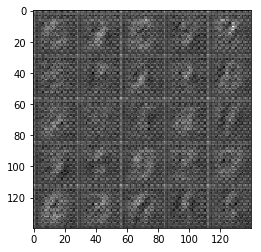

Epoch 1/2... Discriminator Loss: 1.1210... Generator Loss: 5.3926


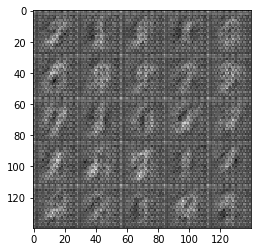

Epoch 1/2... Discriminator Loss: 0.8232... Generator Loss: 3.6381


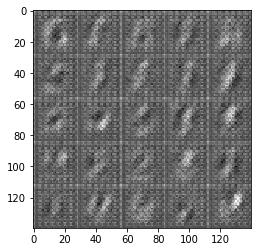

Epoch 1/2... Discriminator Loss: 0.5788... Generator Loss: 2.5897


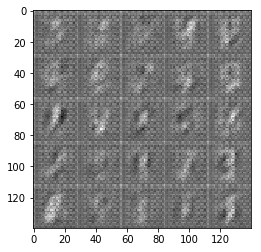

Epoch 1/2... Discriminator Loss: 1.2973... Generator Loss: 0.6602


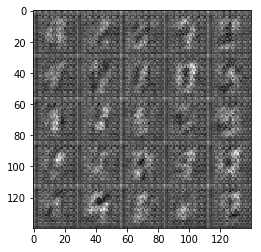

Epoch 1/2... Discriminator Loss: 1.0294... Generator Loss: 0.9483


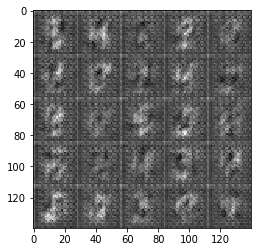

Epoch 1/2... Discriminator Loss: 0.6329... Generator Loss: 1.8985


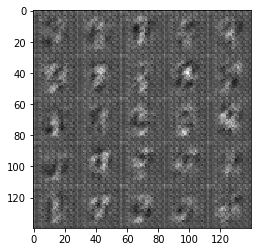

Epoch 1/2... Discriminator Loss: 0.7241... Generator Loss: 1.5383


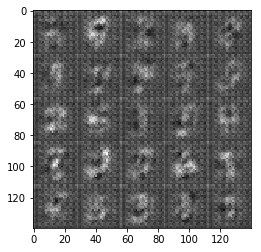

Epoch 1/2... Discriminator Loss: 0.5163... Generator Loss: 2.3923


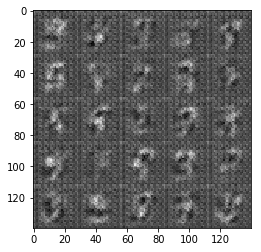

Epoch 1/2... Discriminator Loss: 0.5661... Generator Loss: 3.6936


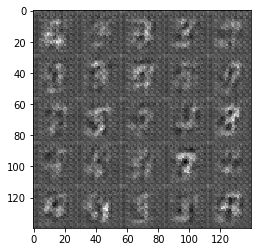

Epoch 1/2... Discriminator Loss: 2.5246... Generator Loss: 0.2683


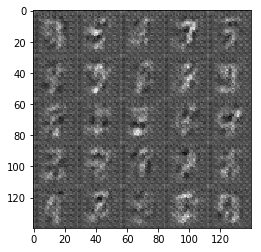

Epoch 1/2... Discriminator Loss: 0.7496... Generator Loss: 4.6925


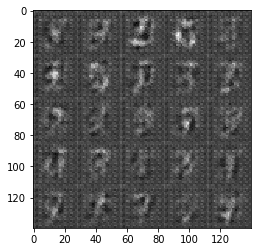

Epoch 1/2... Discriminator Loss: 0.5098... Generator Loss: 2.1865


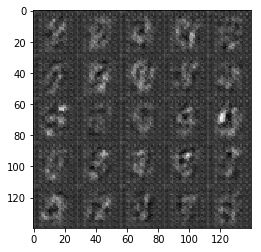

Epoch 1/2... Discriminator Loss: 0.4918... Generator Loss: 2.2671


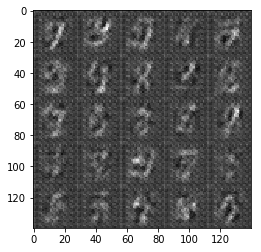

Epoch 1/2... Discriminator Loss: 0.5006... Generator Loss: 3.9842


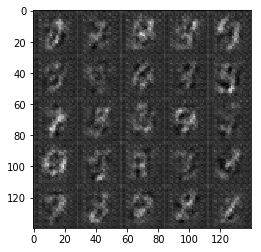

Epoch 1/2... Discriminator Loss: 0.4990... Generator Loss: 2.1662


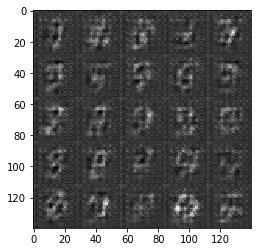

Epoch 1/2... Discriminator Loss: 0.6579... Generator Loss: 1.6425


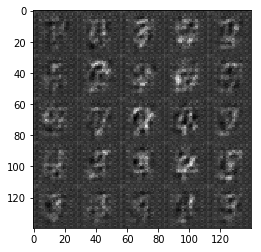

Epoch 1/2... Discriminator Loss: 0.4865... Generator Loss: 2.3526


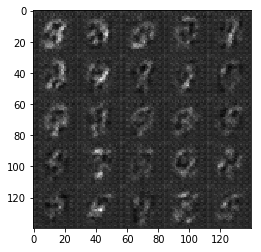

Epoch 1/2... Discriminator Loss: 0.9316... Generator Loss: 1.7860


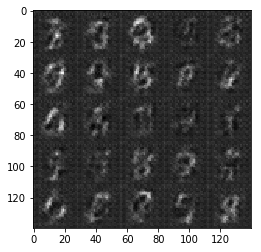

Epoch 1/2... Discriminator Loss: 0.5377... Generator Loss: 2.6908


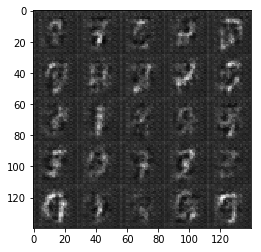

Epoch 1/2... Discriminator Loss: 0.4632... Generator Loss: 3.4912


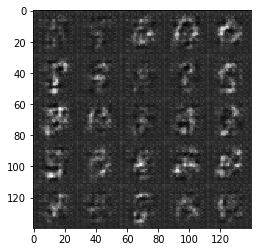

Epoch 1/2... Discriminator Loss: 0.5054... Generator Loss: 2.1200


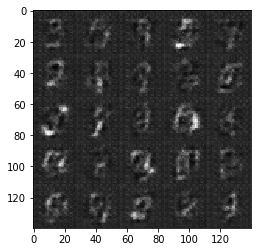

Epoch 1/2... Discriminator Loss: 0.4675... Generator Loss: 2.3375


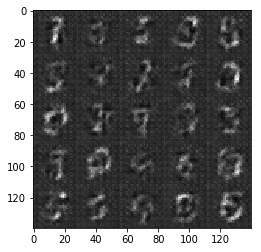

Epoch 1/2... Discriminator Loss: 0.4163... Generator Loss: 3.0784


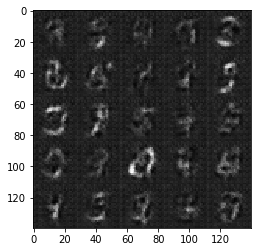

Epoch 1/2... Discriminator Loss: 0.5495... Generator Loss: 2.4977


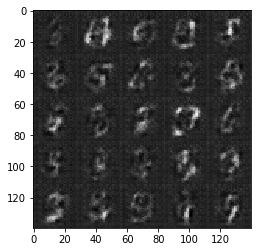

Epoch 1/2... Discriminator Loss: 0.4829... Generator Loss: 4.2868


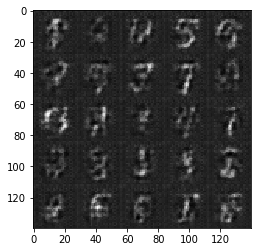

Epoch 1/2... Discriminator Loss: 0.7008... Generator Loss: 1.4589


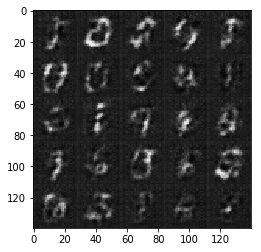

Epoch 1/2... Discriminator Loss: 1.4635... Generator Loss: 5.5818


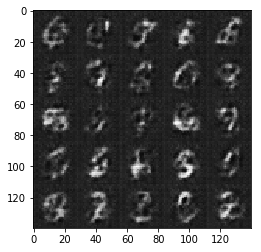

Epoch 1/2... Discriminator Loss: 0.5364... Generator Loss: 3.7635


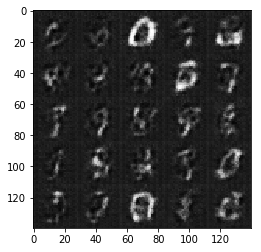

Epoch 1/2... Discriminator Loss: 4.4897... Generator Loss: 0.0378


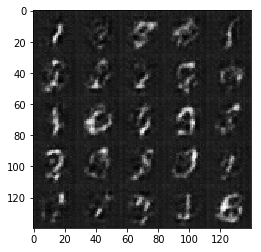

Epoch 1/2... Discriminator Loss: 0.7031... Generator Loss: 1.6844


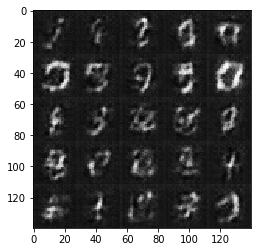

Epoch 1/2... Discriminator Loss: 0.7233... Generator Loss: 1.3611


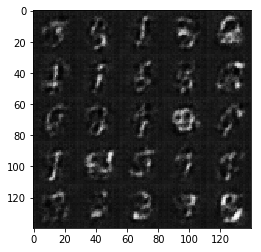

Epoch 1/2... Discriminator Loss: 0.5308... Generator Loss: 2.2359


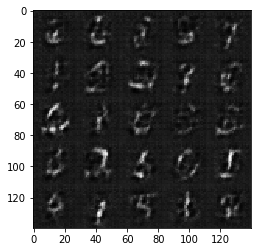

Epoch 1/2... Discriminator Loss: 0.4797... Generator Loss: 2.3775


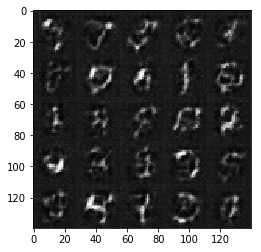

Epoch 1/2... Discriminator Loss: 0.6599... Generator Loss: 1.4590


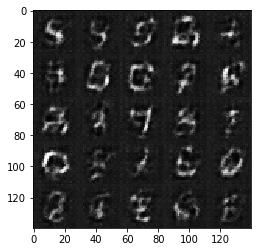

Epoch 1/2... Discriminator Loss: 0.5899... Generator Loss: 3.5591


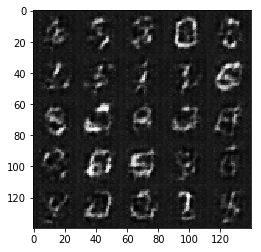

Epoch 1/2... Discriminator Loss: 0.6999... Generator Loss: 4.2388


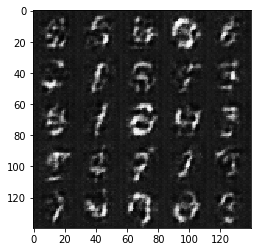

Epoch 1/2... Discriminator Loss: 0.4545... Generator Loss: 3.1467


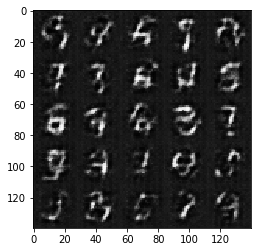

Epoch 1/2... Discriminator Loss: 0.4409... Generator Loss: 2.5722


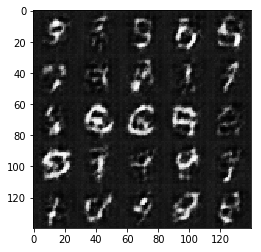

Epoch 1/2... Discriminator Loss: 0.6387... Generator Loss: 1.5947


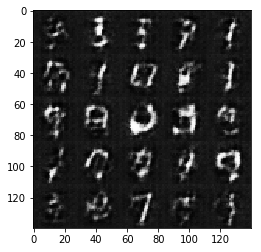

Epoch 1/2... Discriminator Loss: 1.3463... Generator Loss: 0.6883


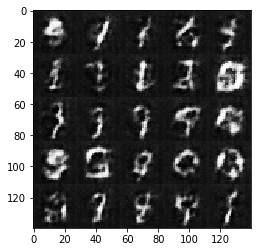

Epoch 1/2... Discriminator Loss: 1.2335... Generator Loss: 0.6996


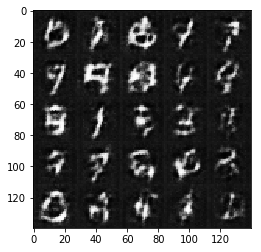

Epoch 1/2... Discriminator Loss: 0.5922... Generator Loss: 1.8752


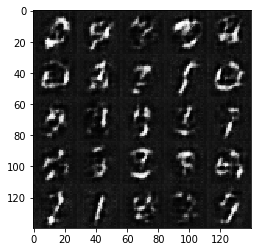

Epoch 1/2... Discriminator Loss: 0.7521... Generator Loss: 1.3490


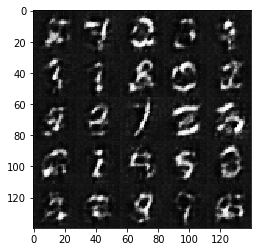

Epoch 1/2... Discriminator Loss: 0.4637... Generator Loss: 2.8972


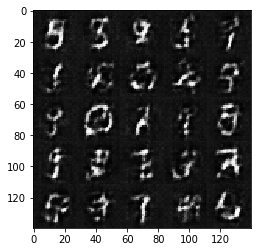

Epoch 1/2... Discriminator Loss: 0.5180... Generator Loss: 2.1549


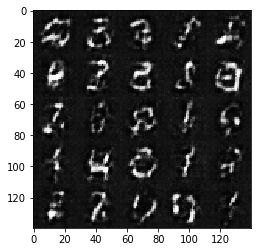

Epoch 1/2... Discriminator Loss: 0.6086... Generator Loss: 1.6713


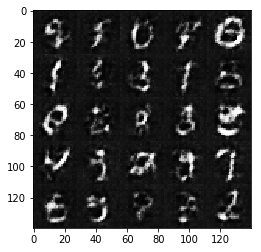

Epoch 1/2... Discriminator Loss: 0.7911... Generator Loss: 3.8892


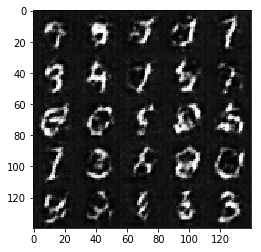

Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 1.3277


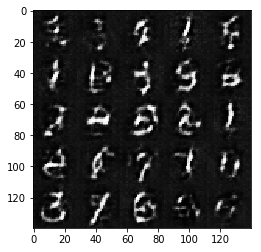

Epoch 1/2... Discriminator Loss: 1.0211... Generator Loss: 0.9563


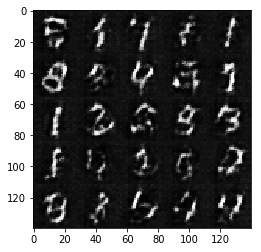

Epoch 1/2... Discriminator Loss: 0.5877... Generator Loss: 2.3013


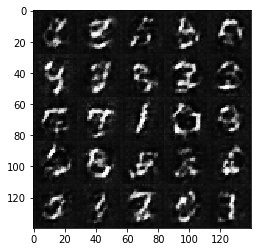

Epoch 1/2... Discriminator Loss: 0.8678... Generator Loss: 3.5990


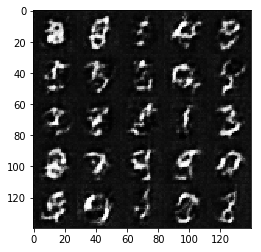

Epoch 1/2... Discriminator Loss: 1.0857... Generator Loss: 0.8173


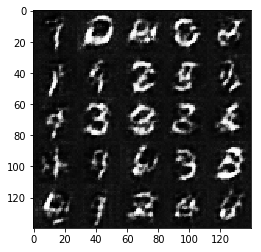

Epoch 1/2... Discriminator Loss: 0.5625... Generator Loss: 1.8942


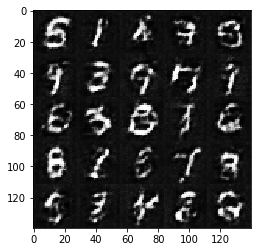

Epoch 1/2... Discriminator Loss: 0.6036... Generator Loss: 1.6744


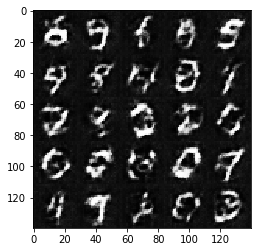

Epoch 1/2... Discriminator Loss: 1.1458... Generator Loss: 0.7345


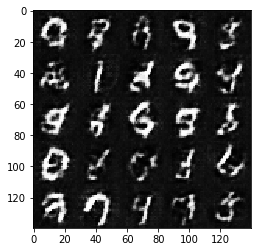

Epoch 1/2... Discriminator Loss: 1.1959... Generator Loss: 1.2683


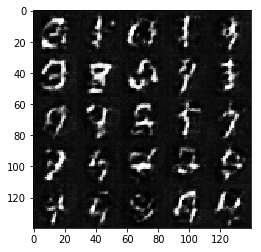

Epoch 1/2... Discriminator Loss: 0.6530... Generator Loss: 1.7015


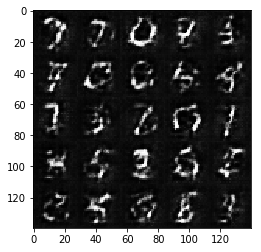

Epoch 1/2... Discriminator Loss: 1.2665... Generator Loss: 0.6463


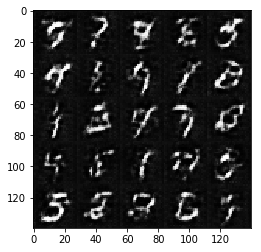

Epoch 1/2... Discriminator Loss: 0.7199... Generator Loss: 1.4843


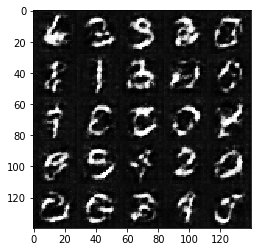

Epoch 1/2... Discriminator Loss: 0.7872... Generator Loss: 3.7980


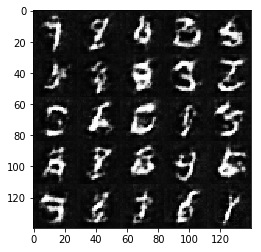

Epoch 1/2... Discriminator Loss: 0.5679... Generator Loss: 2.3983


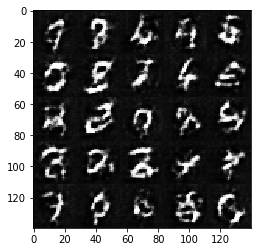

Epoch 1/2... Discriminator Loss: 0.6454... Generator Loss: 1.6200


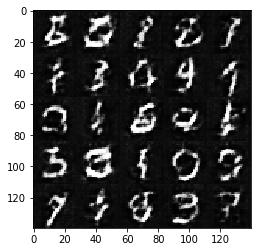

Epoch 1/2... Discriminator Loss: 0.9857... Generator Loss: 1.4537


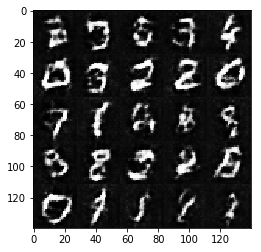

Epoch 1/2... Discriminator Loss: 0.8704... Generator Loss: 1.0963


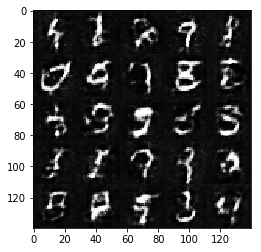

Epoch 1/2... Discriminator Loss: 0.6753... Generator Loss: 1.4408


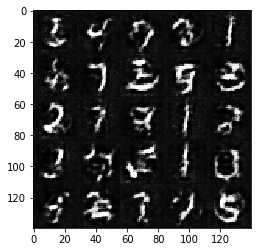

Epoch 1/2... Discriminator Loss: 0.7370... Generator Loss: 2.1744


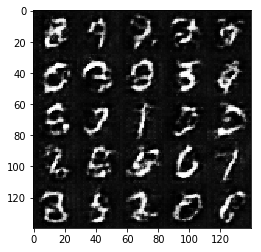

Epoch 1/2... Discriminator Loss: 0.5773... Generator Loss: 1.8419


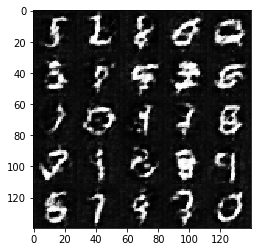

Epoch 1/2... Discriminator Loss: 0.6472... Generator Loss: 2.0226


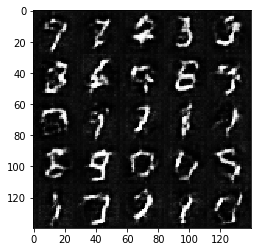

Epoch 1/2... Discriminator Loss: 0.6111... Generator Loss: 1.8245


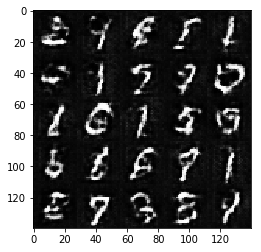

Epoch 1/2... Discriminator Loss: 0.8308... Generator Loss: 1.1095


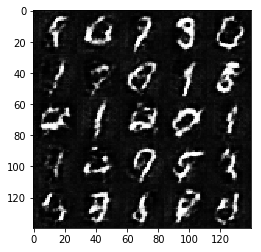

Epoch 1/2... Discriminator Loss: 1.4795... Generator Loss: 0.8889


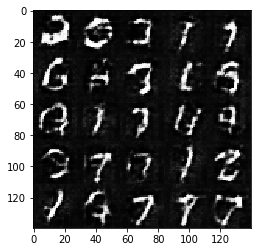

Epoch 1/2... Discriminator Loss: 1.0452... Generator Loss: 3.2885


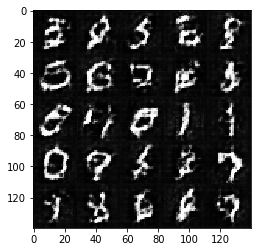

Epoch 1/2... Discriminator Loss: 0.7304... Generator Loss: 1.4023


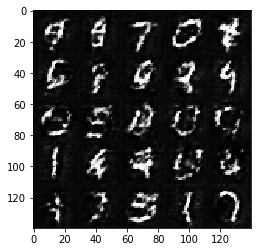

Epoch 1/2... Discriminator Loss: 0.6476... Generator Loss: 1.6828


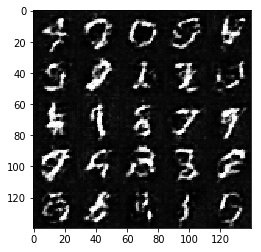

Epoch 1/2... Discriminator Loss: 0.6733... Generator Loss: 1.4971


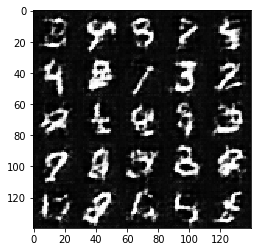

Epoch 1/2... Discriminator Loss: 0.5287... Generator Loss: 2.0542


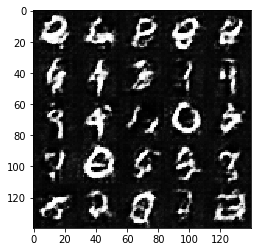

Epoch 1/2... Discriminator Loss: 0.6113... Generator Loss: 1.6093


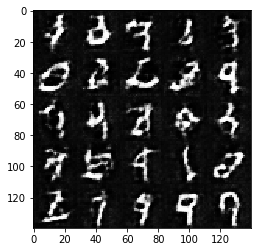

Epoch 1/2... Discriminator Loss: 0.5250... Generator Loss: 1.9611


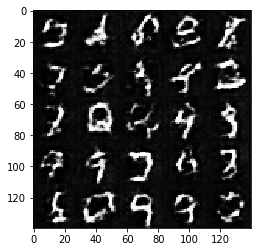

Epoch 1/2... Discriminator Loss: 0.8497... Generator Loss: 2.8978


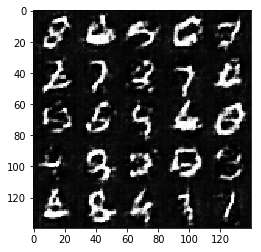

Epoch 1/2... Discriminator Loss: 1.0280... Generator Loss: 2.3997


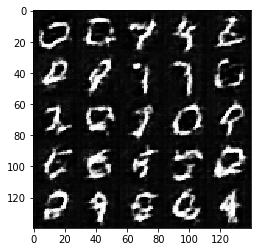

Epoch 1/2... Discriminator Loss: 0.7349... Generator Loss: 2.2126


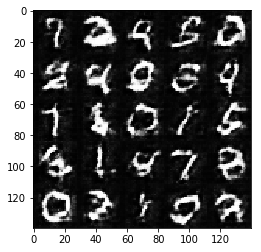

Epoch 1/2... Discriminator Loss: 0.5369... Generator Loss: 2.0070


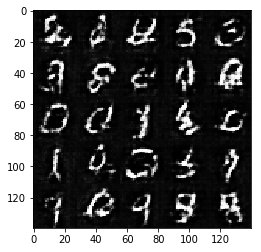

Epoch 1/2... Discriminator Loss: 0.6551... Generator Loss: 1.9430


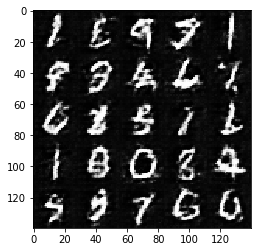

Epoch 2/2... Discriminator Loss: 1.0312... Generator Loss: 0.8646


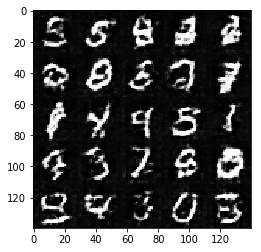

Epoch 2/2... Discriminator Loss: 0.8453... Generator Loss: 1.1301


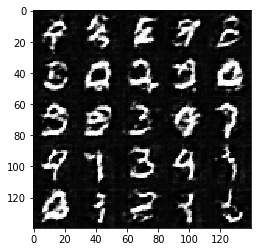

Epoch 2/2... Discriminator Loss: 0.7050... Generator Loss: 2.5292


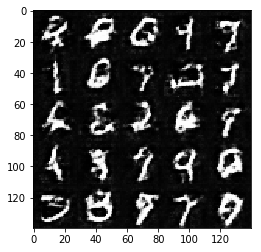

Epoch 2/2... Discriminator Loss: 0.5873... Generator Loss: 1.7159


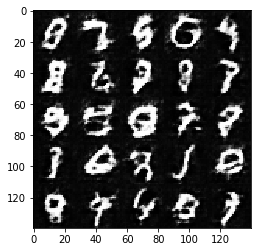

Epoch 2/2... Discriminator Loss: 1.1384... Generator Loss: 2.9186


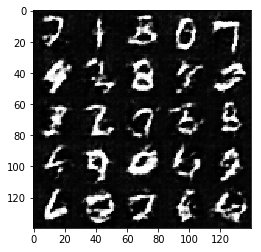

Epoch 2/2... Discriminator Loss: 0.9210... Generator Loss: 1.3300


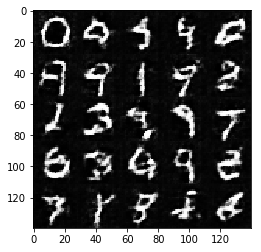

Epoch 2/2... Discriminator Loss: 0.7539... Generator Loss: 1.9860


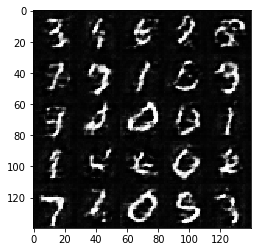

Epoch 2/2... Discriminator Loss: 0.9311... Generator Loss: 1.0658


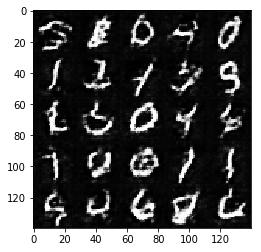

Epoch 2/2... Discriminator Loss: 0.6866... Generator Loss: 1.5566


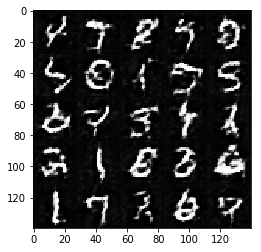

Epoch 2/2... Discriminator Loss: 0.6833... Generator Loss: 1.7211


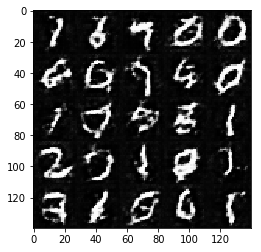

Epoch 2/2... Discriminator Loss: 1.4857... Generator Loss: 0.5126


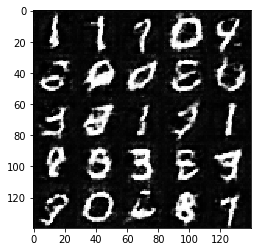

Epoch 2/2... Discriminator Loss: 0.9168... Generator Loss: 1.0281


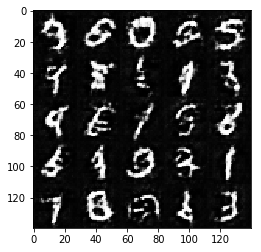

Epoch 2/2... Discriminator Loss: 2.9245... Generator Loss: 5.8303


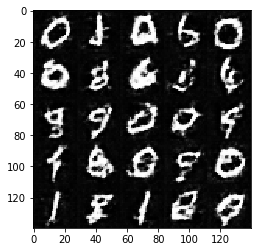

Epoch 2/2... Discriminator Loss: 1.2625... Generator Loss: 0.7287


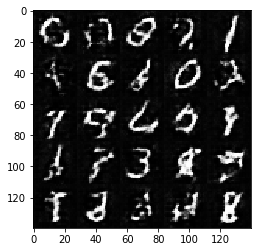

Epoch 2/2... Discriminator Loss: 0.9755... Generator Loss: 0.9131


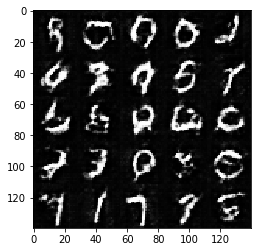

Epoch 2/2... Discriminator Loss: 0.7488... Generator Loss: 1.3315


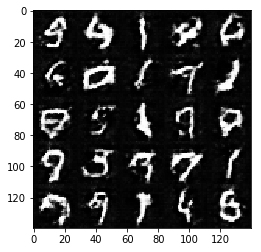

Epoch 2/2... Discriminator Loss: 1.8488... Generator Loss: 0.4385


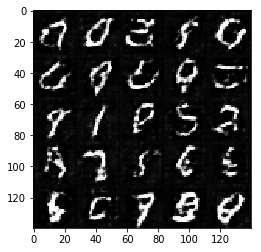

Epoch 2/2... Discriminator Loss: 0.8805... Generator Loss: 1.1559


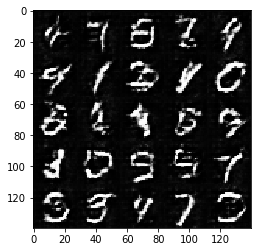

Epoch 2/2... Discriminator Loss: 0.7058... Generator Loss: 1.4853


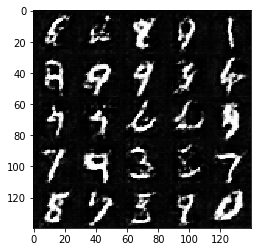

Epoch 2/2... Discriminator Loss: 0.7946... Generator Loss: 1.2592


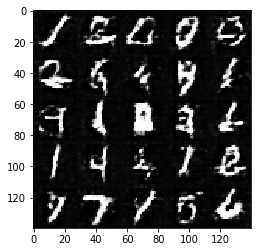

Epoch 2/2... Discriminator Loss: 2.8395... Generator Loss: 0.2001


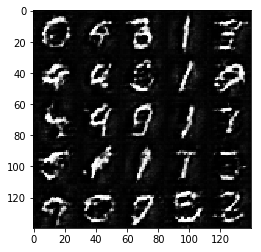

Epoch 2/2... Discriminator Loss: 0.6975... Generator Loss: 1.7087


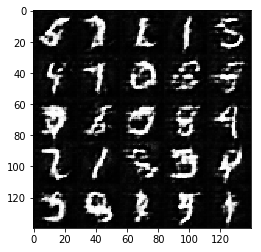

Epoch 2/2... Discriminator Loss: 0.9628... Generator Loss: 0.9827


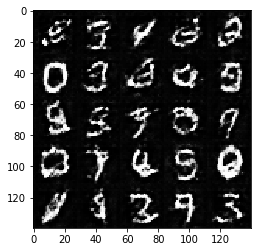

Epoch 2/2... Discriminator Loss: 0.7893... Generator Loss: 2.0487


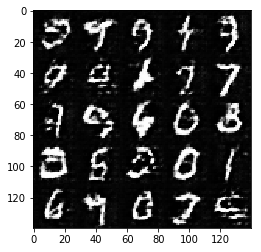

Epoch 2/2... Discriminator Loss: 0.7230... Generator Loss: 1.4318


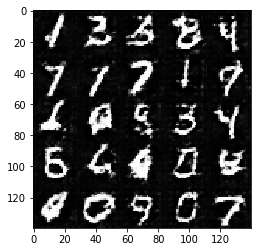

Epoch 2/2... Discriminator Loss: 0.7342... Generator Loss: 1.3525


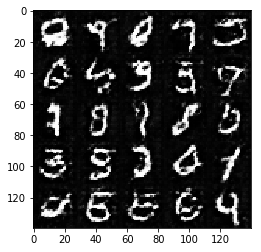

Epoch 2/2... Discriminator Loss: 1.1758... Generator Loss: 0.7741


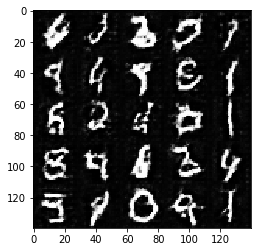

Epoch 2/2... Discriminator Loss: 1.2270... Generator Loss: 0.6192


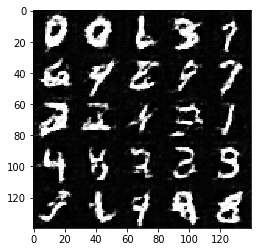

Epoch 2/2... Discriminator Loss: 0.7793... Generator Loss: 1.6284


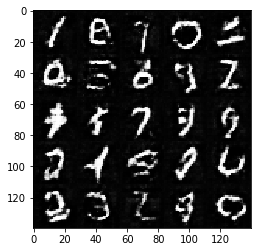

Epoch 2/2... Discriminator Loss: 0.8626... Generator Loss: 1.3540


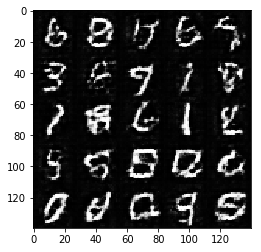

Epoch 2/2... Discriminator Loss: 0.9692... Generator Loss: 0.9707


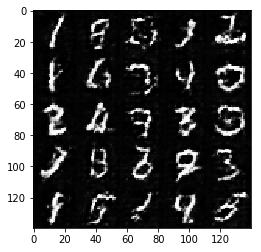

Epoch 2/2... Discriminator Loss: 0.7570... Generator Loss: 1.3815


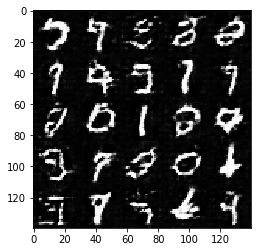

Epoch 2/2... Discriminator Loss: 1.2334... Generator Loss: 0.6565


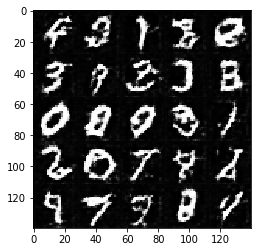

Epoch 2/2... Discriminator Loss: 1.1760... Generator Loss: 2.9876


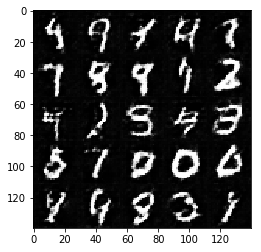

Epoch 2/2... Discriminator Loss: 1.7421... Generator Loss: 0.7979


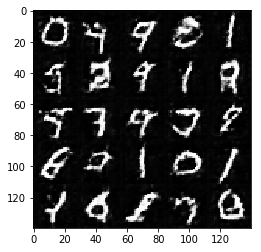

Epoch 2/2... Discriminator Loss: 0.7871... Generator Loss: 2.7112


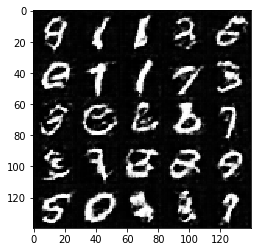

Epoch 2/2... Discriminator Loss: 0.9019... Generator Loss: 1.0864


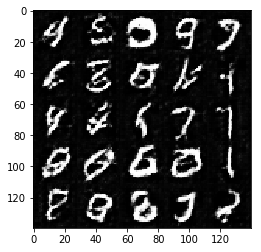

Epoch 2/2... Discriminator Loss: 1.0896... Generator Loss: 0.8472


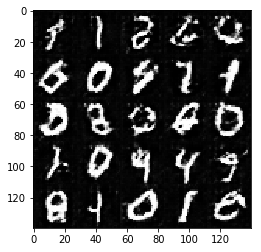

Epoch 2/2... Discriminator Loss: 1.5195... Generator Loss: 0.7374


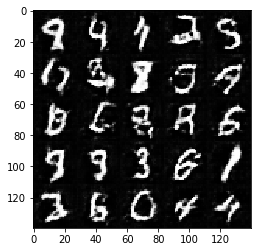

Epoch 2/2... Discriminator Loss: 0.7857... Generator Loss: 1.2675


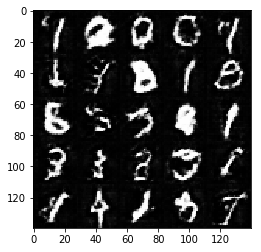

Epoch 2/2... Discriminator Loss: 1.2998... Generator Loss: 0.6324


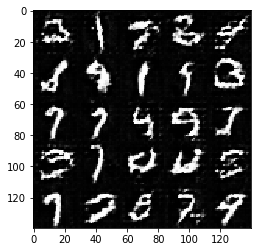

Epoch 2/2... Discriminator Loss: 0.7075... Generator Loss: 1.4801


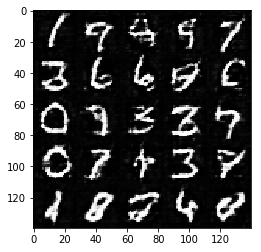

Epoch 2/2... Discriminator Loss: 0.6276... Generator Loss: 1.8873


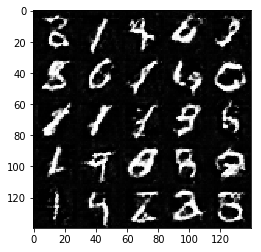

Epoch 2/2... Discriminator Loss: 0.9178... Generator Loss: 1.0571


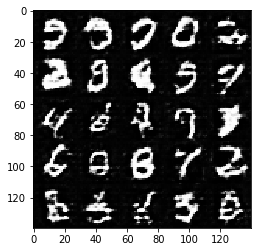

Epoch 2/2... Discriminator Loss: 1.2587... Generator Loss: 0.7492


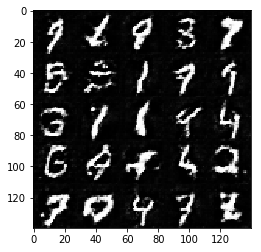

Epoch 2/2... Discriminator Loss: 0.9019... Generator Loss: 1.1020


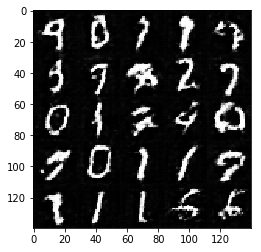

Epoch 2/2... Discriminator Loss: 0.6600... Generator Loss: 1.8650


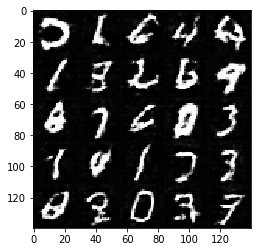

Epoch 2/2... Discriminator Loss: 3.2920... Generator Loss: 0.1287


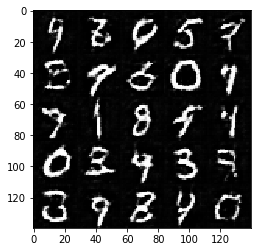

Epoch 2/2... Discriminator Loss: 0.8119... Generator Loss: 1.6786


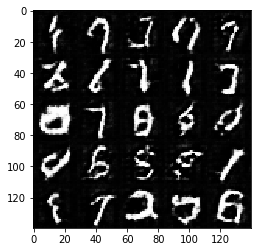

Epoch 2/2... Discriminator Loss: 1.0633... Generator Loss: 0.8534


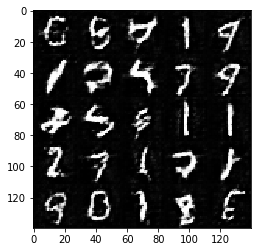

Epoch 2/2... Discriminator Loss: 2.1352... Generator Loss: 0.3208


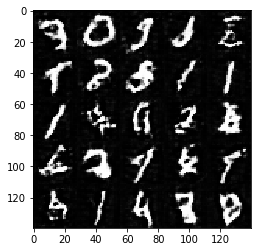

Epoch 2/2... Discriminator Loss: 1.6858... Generator Loss: 4.5229


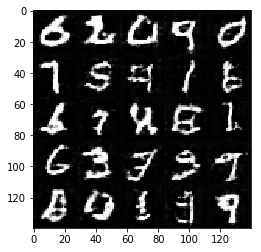

Epoch 2/2... Discriminator Loss: 0.7109... Generator Loss: 2.3620


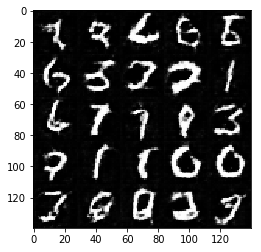

Epoch 2/2... Discriminator Loss: 0.8019... Generator Loss: 1.2494


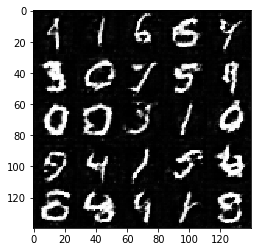

Epoch 2/2... Discriminator Loss: 0.8064... Generator Loss: 1.7501


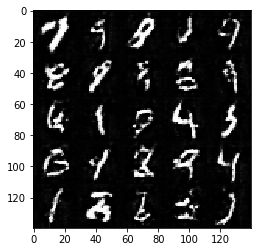

Epoch 2/2... Discriminator Loss: 0.6320... Generator Loss: 1.6201


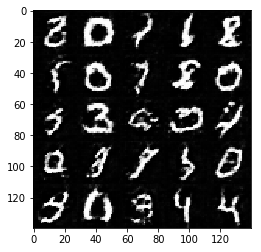

Epoch 2/2... Discriminator Loss: 1.7878... Generator Loss: 0.4247


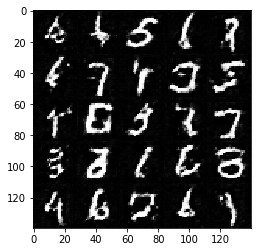

Epoch 2/2... Discriminator Loss: 2.3267... Generator Loss: 0.2994


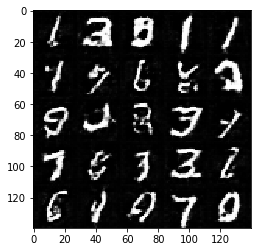

Epoch 2/2... Discriminator Loss: 0.8133... Generator Loss: 1.5672


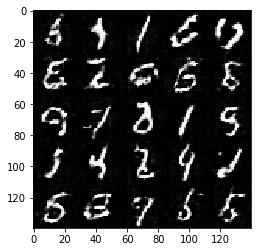

Epoch 2/2... Discriminator Loss: 0.9250... Generator Loss: 1.0149


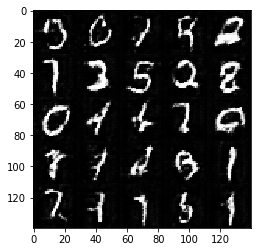

Epoch 2/2... Discriminator Loss: 0.8473... Generator Loss: 1.2016


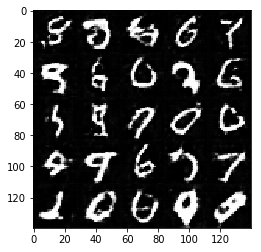

Epoch 2/2... Discriminator Loss: 0.8480... Generator Loss: 1.1481


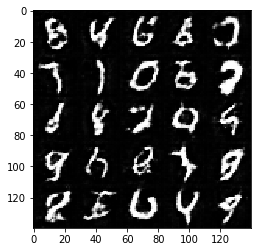

Epoch 2/2... Discriminator Loss: 1.0043... Generator Loss: 0.8721


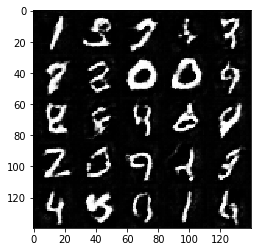

Epoch 2/2... Discriminator Loss: 0.6917... Generator Loss: 1.5320


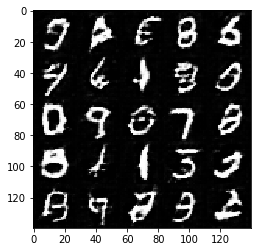

Epoch 2/2... Discriminator Loss: 0.9971... Generator Loss: 0.8922


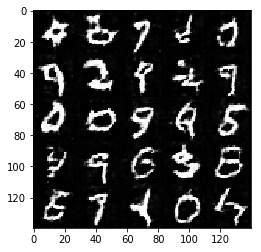

Epoch 2/2... Discriminator Loss: 0.8428... Generator Loss: 1.2636


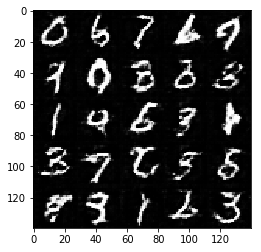

Epoch 2/2... Discriminator Loss: 1.2152... Generator Loss: 0.7421


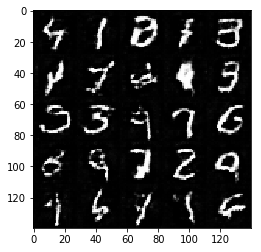

Epoch 2/2... Discriminator Loss: 1.2279... Generator Loss: 0.9139


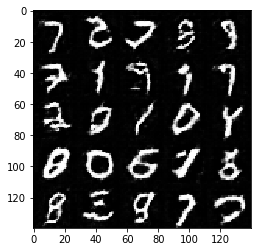

Epoch 2/2... Discriminator Loss: 0.9135... Generator Loss: 1.1839


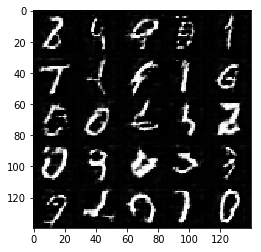

Epoch 2/2... Discriminator Loss: 0.7390... Generator Loss: 1.3247


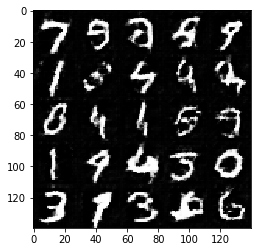

Epoch 2/2... Discriminator Loss: 0.7532... Generator Loss: 1.3453


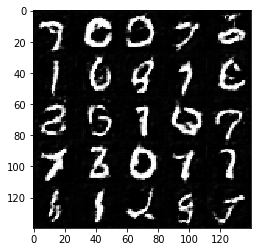

Epoch 2/2... Discriminator Loss: 0.6745... Generator Loss: 1.4779


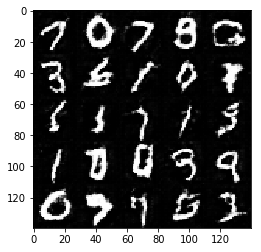

Epoch 2/2... Discriminator Loss: 0.7384... Generator Loss: 2.0924


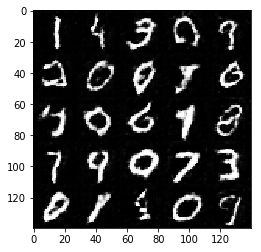

Epoch 2/2... Discriminator Loss: 0.7906... Generator Loss: 3.0497


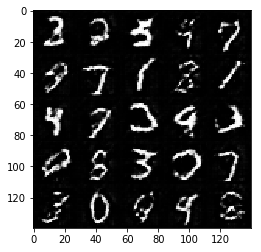

Epoch 2/2... Discriminator Loss: 1.8407... Generator Loss: 0.4089


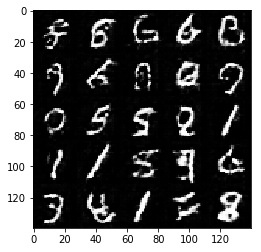

Epoch 2/2... Discriminator Loss: 1.4820... Generator Loss: 0.5424


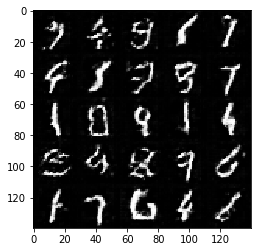

Epoch 2/2... Discriminator Loss: 1.8467... Generator Loss: 0.3573


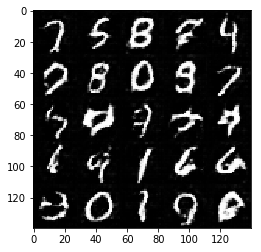

Epoch 2/2... Discriminator Loss: 1.7498... Generator Loss: 0.5792


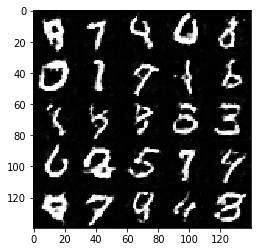

Epoch 2/2... Discriminator Loss: 0.9218... Generator Loss: 1.0431


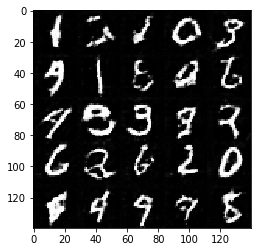

Epoch 2/2... Discriminator Loss: 0.9013... Generator Loss: 1.1321


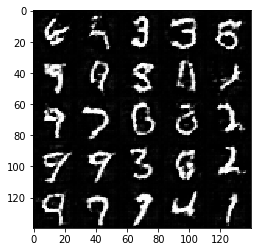

Epoch 2/2... Discriminator Loss: 0.8602... Generator Loss: 1.8972


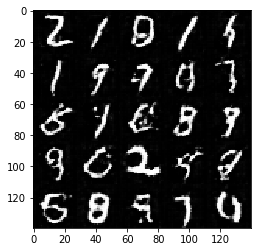

Epoch 2/2... Discriminator Loss: 0.6667... Generator Loss: 1.5900


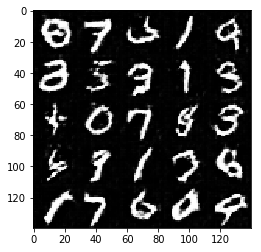

Epoch 2/2... Discriminator Loss: 0.9047... Generator Loss: 1.2623


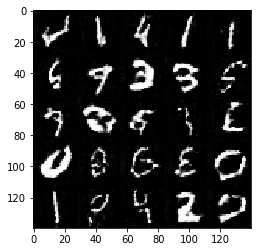

Epoch 2/2... Discriminator Loss: 0.8121... Generator Loss: 1.2082


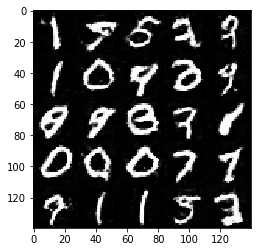

Epoch 2/2... Discriminator Loss: 1.2797... Generator Loss: 0.7524


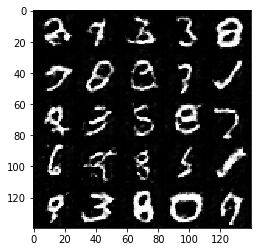

Epoch 2/2... Discriminator Loss: 1.2137... Generator Loss: 4.0091


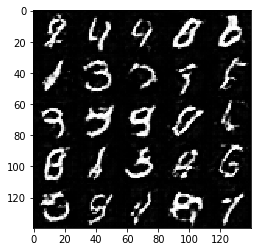

Epoch 2/2... Discriminator Loss: 0.8872... Generator Loss: 1.1242


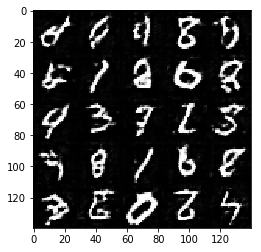

Epoch 2/2... Discriminator Loss: 0.9599... Generator Loss: 1.1170


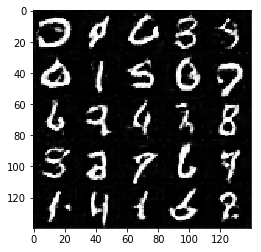

Epoch 2/2... Discriminator Loss: 0.7789... Generator Loss: 1.3978


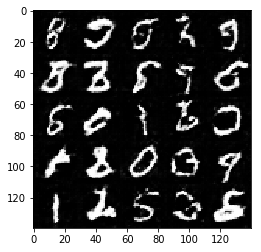

Epoch 2/2... Discriminator Loss: 0.8132... Generator Loss: 1.3544


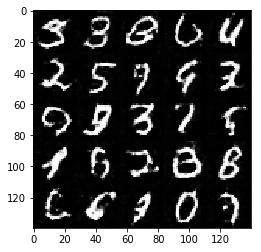

Epoch 2/2... Discriminator Loss: 1.1553... Generator Loss: 0.7836


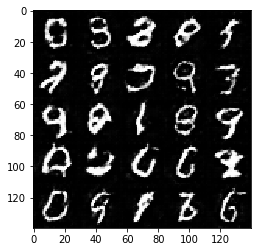

Epoch 2/2... Discriminator Loss: 0.8081... Generator Loss: 1.2357


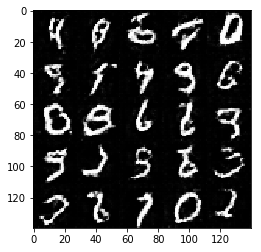

Epoch 2/2... Discriminator Loss: 0.7752... Generator Loss: 1.2557


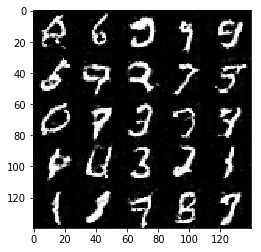

Epoch 2/2... Discriminator Loss: 0.8183... Generator Loss: 1.3025


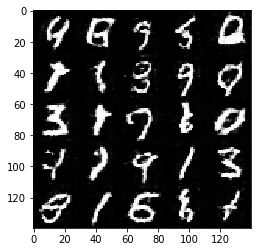

In [12]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 2.1842... Generator Loss: 0.3172


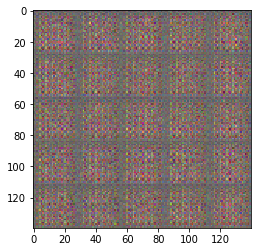

Epoch 1/1... Discriminator Loss: 5.1264... Generator Loss: 0.1389


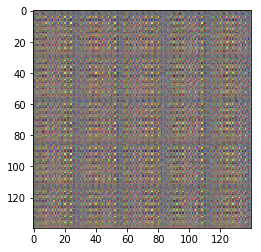

Epoch 1/1... Discriminator Loss: 1.8499... Generator Loss: 0.8107


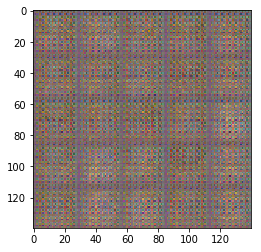

Epoch 1/1... Discriminator Loss: 0.4847... Generator Loss: 3.1150


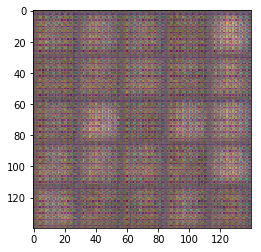

Epoch 1/1... Discriminator Loss: 1.0787... Generator Loss: 2.3384


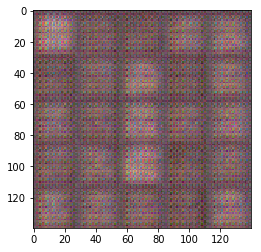

Epoch 1/1... Discriminator Loss: 0.7781... Generator Loss: 1.7420


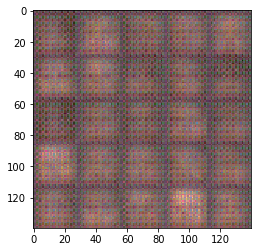

Epoch 1/1... Discriminator Loss: 0.6670... Generator Loss: 2.3396


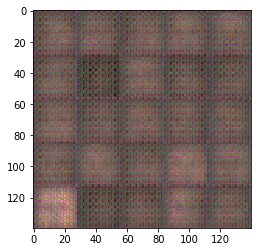

Epoch 1/1... Discriminator Loss: 0.9396... Generator Loss: 1.1890


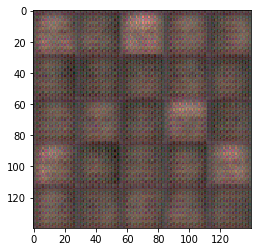

Epoch 1/1... Discriminator Loss: 1.9784... Generator Loss: 0.3027


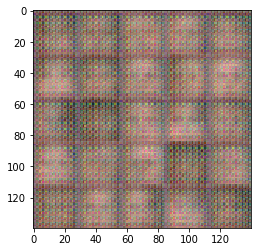

Epoch 1/1... Discriminator Loss: 1.6317... Generator Loss: 0.6180


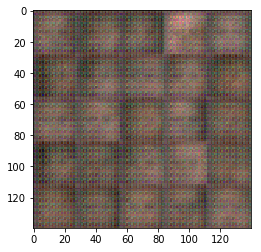

Epoch 1/1... Discriminator Loss: 0.8182... Generator Loss: 1.3577


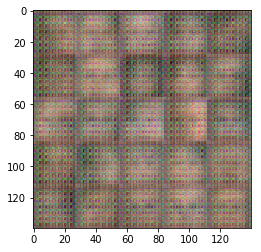

Epoch 1/1... Discriminator Loss: 0.9827... Generator Loss: 1.5183


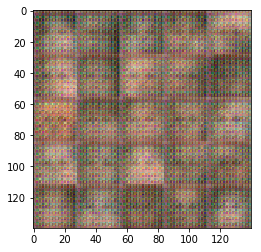

Epoch 1/1... Discriminator Loss: 0.8990... Generator Loss: 1.3298


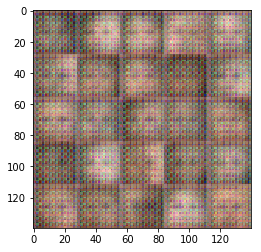

Epoch 1/1... Discriminator Loss: 0.8934... Generator Loss: 1.2134


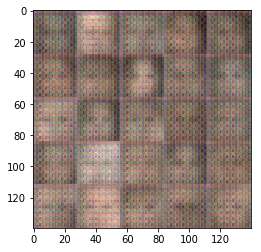

Epoch 1/1... Discriminator Loss: 0.8299... Generator Loss: 1.9066


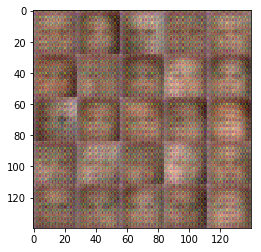

Epoch 1/1... Discriminator Loss: 1.4083... Generator Loss: 0.7275


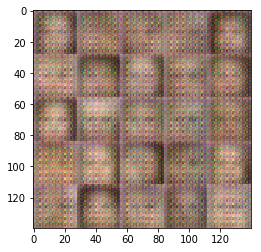

Epoch 1/1... Discriminator Loss: 0.8692... Generator Loss: 1.4142


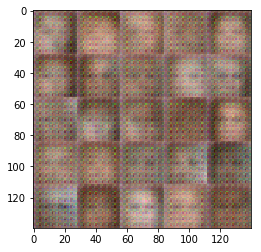

Epoch 1/1... Discriminator Loss: 1.4536... Generator Loss: 0.4994


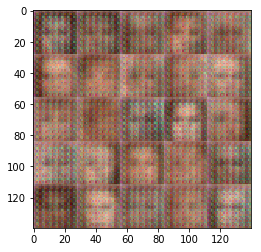

Epoch 1/1... Discriminator Loss: 0.7320... Generator Loss: 1.8795


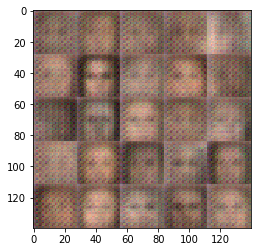

Epoch 1/1... Discriminator Loss: 0.6933... Generator Loss: 1.6967


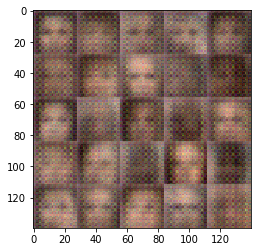

Epoch 1/1... Discriminator Loss: 1.0605... Generator Loss: 1.7072


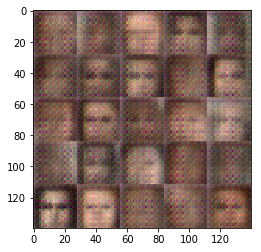

Epoch 1/1... Discriminator Loss: 1.8159... Generator Loss: 3.6148


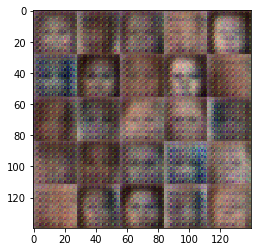

Epoch 1/1... Discriminator Loss: 2.2511... Generator Loss: 0.2701


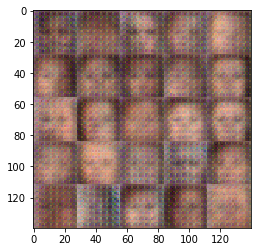

Epoch 1/1... Discriminator Loss: 1.5734... Generator Loss: 3.9502


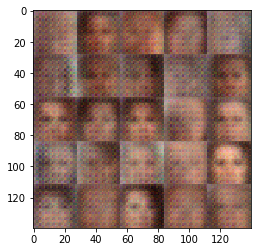

Epoch 1/1... Discriminator Loss: 1.0122... Generator Loss: 1.9311


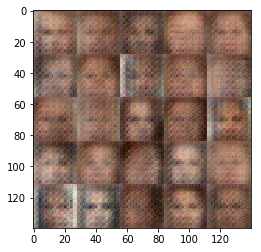

Epoch 1/1... Discriminator Loss: 1.7336... Generator Loss: 0.6306


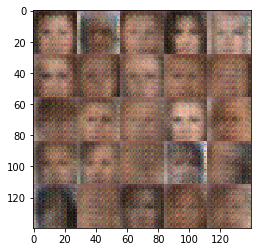

Epoch 1/1... Discriminator Loss: 0.9257... Generator Loss: 1.2299


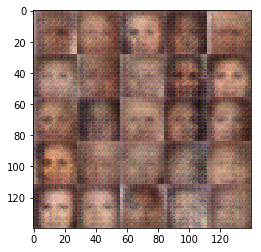

Epoch 1/1... Discriminator Loss: 0.8269... Generator Loss: 1.7843


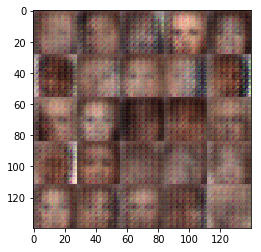

Epoch 1/1... Discriminator Loss: 1.6423... Generator Loss: 0.4582


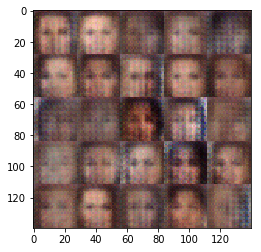

Epoch 1/1... Discriminator Loss: 1.0229... Generator Loss: 1.4793


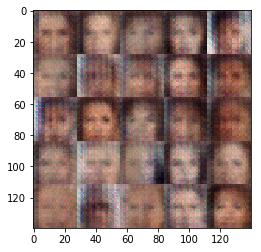

Epoch 1/1... Discriminator Loss: 1.2177... Generator Loss: 1.6967


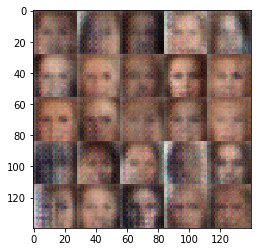

Epoch 1/1... Discriminator Loss: 1.2033... Generator Loss: 0.7850


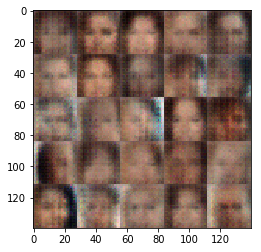

Epoch 1/1... Discriminator Loss: 1.1607... Generator Loss: 0.8557


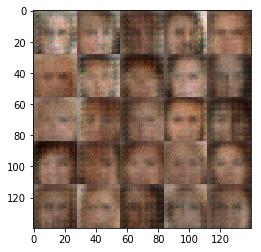

Epoch 1/1... Discriminator Loss: 1.1272... Generator Loss: 0.9988


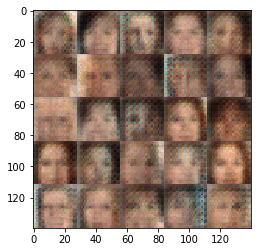

Epoch 1/1... Discriminator Loss: 1.3266... Generator Loss: 0.6411


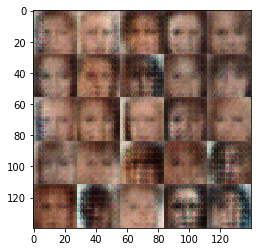

Epoch 1/1... Discriminator Loss: 1.1118... Generator Loss: 1.3105


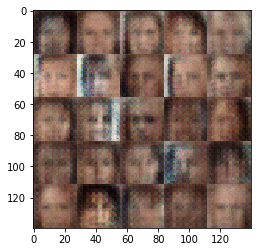

Epoch 1/1... Discriminator Loss: 1.2245... Generator Loss: 0.7314


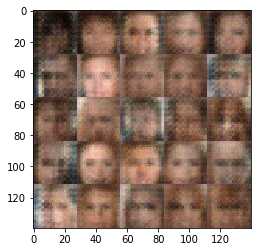

Epoch 1/1... Discriminator Loss: 1.9494... Generator Loss: 0.3743


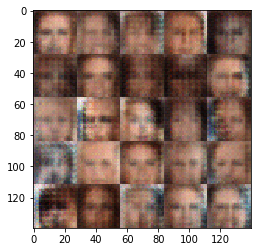

Epoch 1/1... Discriminator Loss: 1.0361... Generator Loss: 1.1525


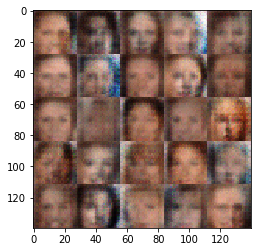

Epoch 1/1... Discriminator Loss: 1.3729... Generator Loss: 0.6209


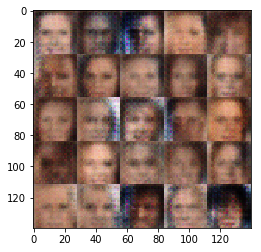

Epoch 1/1... Discriminator Loss: 1.1330... Generator Loss: 0.7992


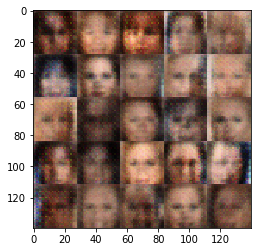

Epoch 1/1... Discriminator Loss: 0.9310... Generator Loss: 1.5678


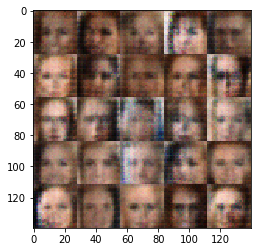

Epoch 1/1... Discriminator Loss: 1.1355... Generator Loss: 0.7449


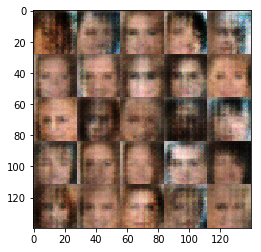

Epoch 1/1... Discriminator Loss: 1.0602... Generator Loss: 0.9435


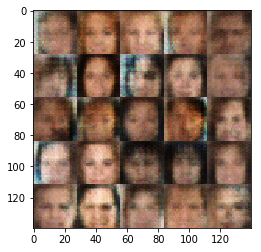

Epoch 1/1... Discriminator Loss: 0.8765... Generator Loss: 1.8264


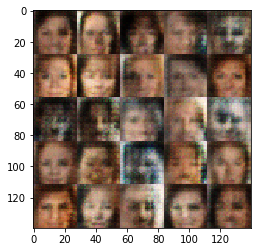

Epoch 1/1... Discriminator Loss: 1.5633... Generator Loss: 0.4598


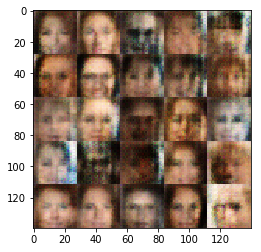

Epoch 1/1... Discriminator Loss: 1.1664... Generator Loss: 0.9302


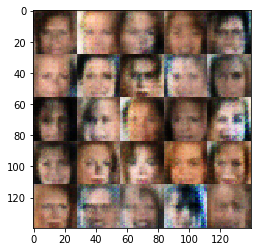

Epoch 1/1... Discriminator Loss: 1.1108... Generator Loss: 1.7779


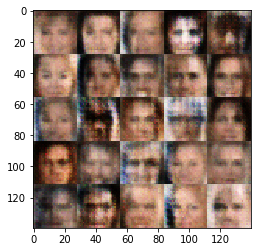

Epoch 1/1... Discriminator Loss: 1.4608... Generator Loss: 2.4102


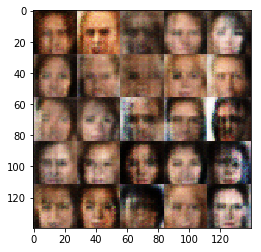

Epoch 1/1... Discriminator Loss: 1.7464... Generator Loss: 0.4072


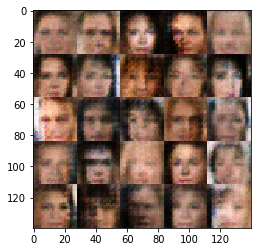

Epoch 1/1... Discriminator Loss: 1.4795... Generator Loss: 0.5181


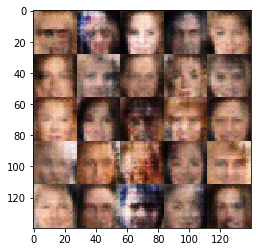

Epoch 1/1... Discriminator Loss: 1.0374... Generator Loss: 1.1683


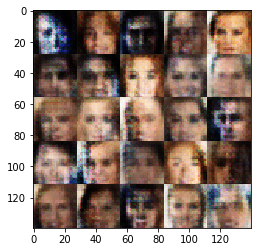

Epoch 1/1... Discriminator Loss: 1.9145... Generator Loss: 3.5639


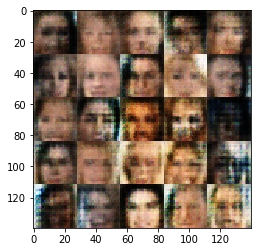

Epoch 1/1... Discriminator Loss: 1.0000... Generator Loss: 1.5753


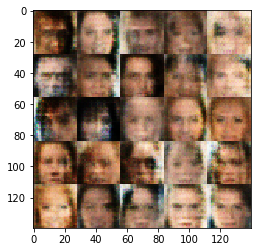

Epoch 1/1... Discriminator Loss: 1.1320... Generator Loss: 2.1229


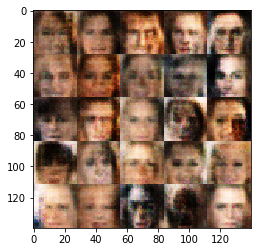

Epoch 1/1... Discriminator Loss: 1.1830... Generator Loss: 0.7115


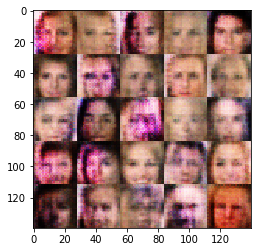

Epoch 1/1... Discriminator Loss: 0.9113... Generator Loss: 1.7694


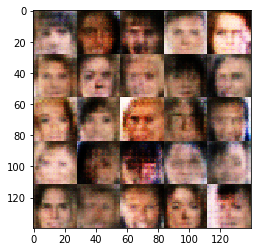

Epoch 1/1... Discriminator Loss: 1.4444... Generator Loss: 0.5975


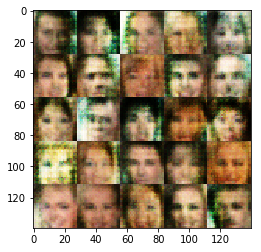

Epoch 1/1... Discriminator Loss: 0.9596... Generator Loss: 1.1185


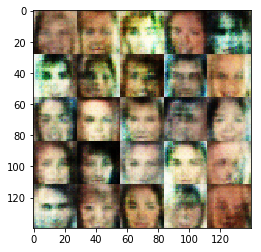

Epoch 1/1... Discriminator Loss: 0.9619... Generator Loss: 1.3475


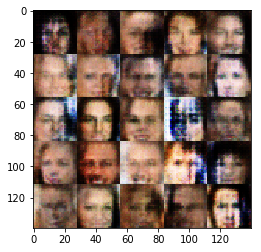

Epoch 1/1... Discriminator Loss: 1.0414... Generator Loss: 1.1423


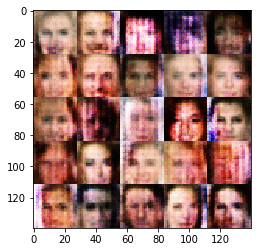

Epoch 1/1... Discriminator Loss: 0.9789... Generator Loss: 1.1265


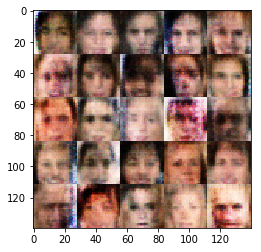

Epoch 1/1... Discriminator Loss: 1.0784... Generator Loss: 1.3950


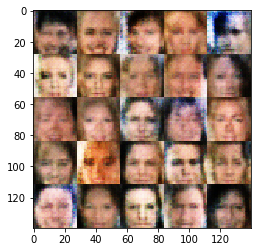

Epoch 1/1... Discriminator Loss: 1.1263... Generator Loss: 1.1043


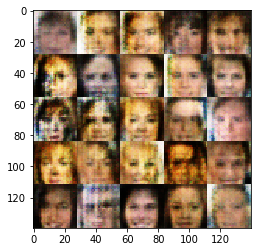

Epoch 1/1... Discriminator Loss: 2.0851... Generator Loss: 0.2587


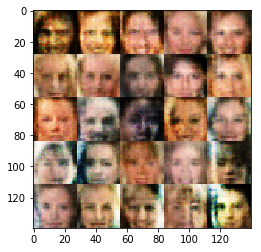

Epoch 1/1... Discriminator Loss: 1.5177... Generator Loss: 0.4582


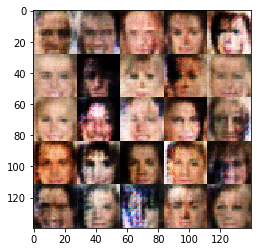

Epoch 1/1... Discriminator Loss: 1.2701... Generator Loss: 0.5898


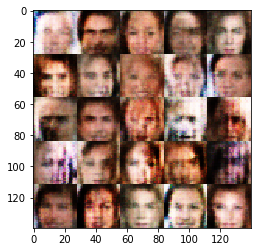

Epoch 1/1... Discriminator Loss: 1.4951... Generator Loss: 2.3711


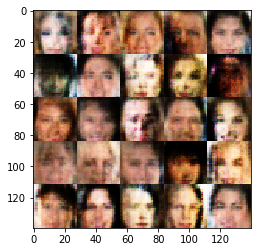

Epoch 1/1... Discriminator Loss: 1.0082... Generator Loss: 0.9046


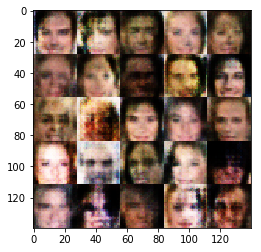

Epoch 1/1... Discriminator Loss: 1.1995... Generator Loss: 1.5469


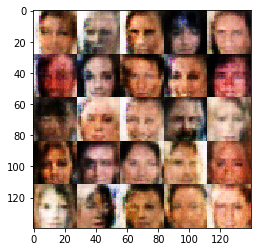

Epoch 1/1... Discriminator Loss: 1.6569... Generator Loss: 0.4192


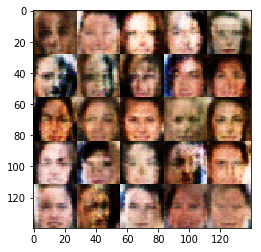

Epoch 1/1... Discriminator Loss: 1.5700... Generator Loss: 0.4250


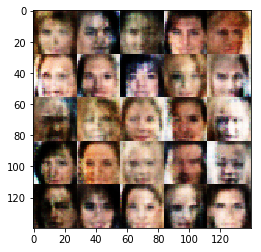

Epoch 1/1... Discriminator Loss: 1.8745... Generator Loss: 0.3198


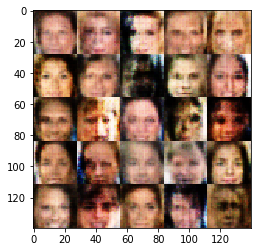

Epoch 1/1... Discriminator Loss: 1.2241... Generator Loss: 2.3750


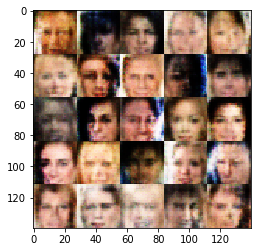

Epoch 1/1... Discriminator Loss: 1.0636... Generator Loss: 1.4730


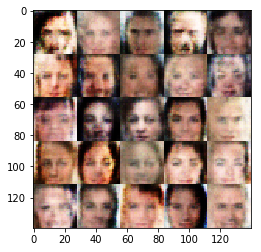

Epoch 1/1... Discriminator Loss: 1.0685... Generator Loss: 1.5037


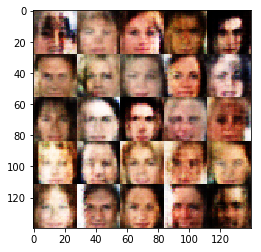

Epoch 1/1... Discriminator Loss: 1.1589... Generator Loss: 1.9679


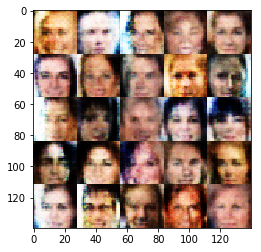

Epoch 1/1... Discriminator Loss: 1.1613... Generator Loss: 1.2182


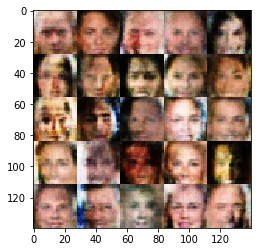

Epoch 1/1... Discriminator Loss: 1.2851... Generator Loss: 0.5958


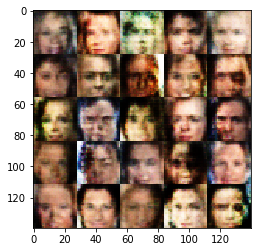

Epoch 1/1... Discriminator Loss: 0.8798... Generator Loss: 1.3731


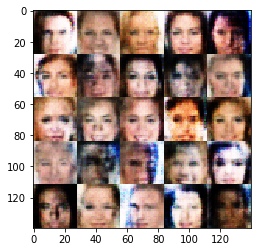

Epoch 1/1... Discriminator Loss: 1.3397... Generator Loss: 2.2799


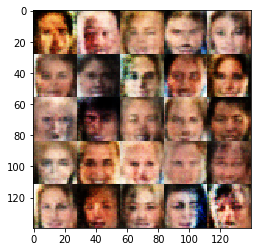

Epoch 1/1... Discriminator Loss: 1.1074... Generator Loss: 1.7274


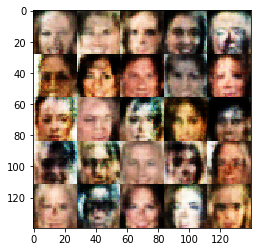

Epoch 1/1... Discriminator Loss: 0.9761... Generator Loss: 1.0071


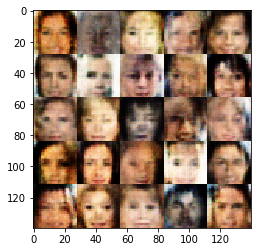

Epoch 1/1... Discriminator Loss: 0.9203... Generator Loss: 1.2218


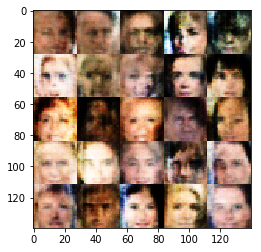

Epoch 1/1... Discriminator Loss: 1.7104... Generator Loss: 0.3972


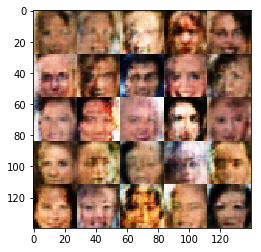

Epoch 1/1... Discriminator Loss: 1.2385... Generator Loss: 0.6207


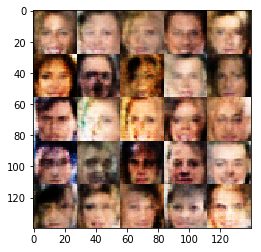

Epoch 1/1... Discriminator Loss: 1.3078... Generator Loss: 0.5716


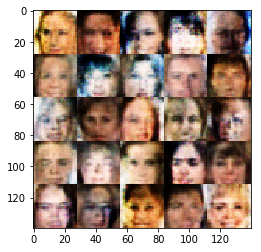

Epoch 1/1... Discriminator Loss: 1.2017... Generator Loss: 0.9901


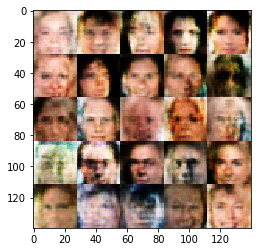

Epoch 1/1... Discriminator Loss: 1.4805... Generator Loss: 0.4657


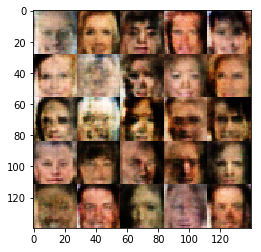

Epoch 1/1... Discriminator Loss: 1.1931... Generator Loss: 1.3778


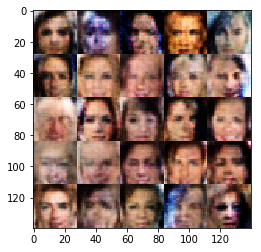

Epoch 1/1... Discriminator Loss: 1.1946... Generator Loss: 1.8832


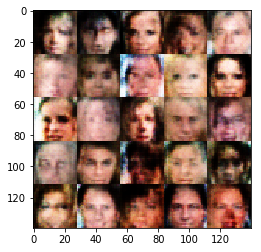

Epoch 1/1... Discriminator Loss: 1.2033... Generator Loss: 0.6911


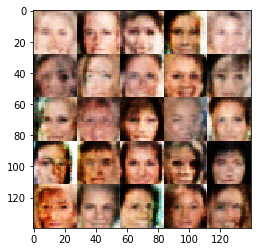

Epoch 1/1... Discriminator Loss: 1.3832... Generator Loss: 0.4903


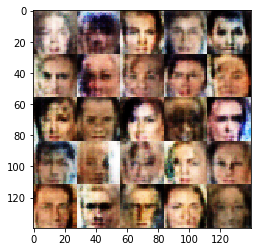

Epoch 1/1... Discriminator Loss: 0.9519... Generator Loss: 1.0807


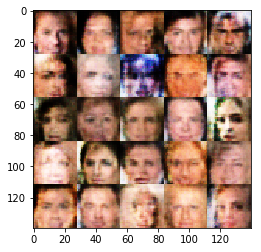

Epoch 1/1... Discriminator Loss: 2.0841... Generator Loss: 0.2843


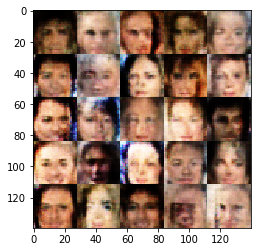

Epoch 1/1... Discriminator Loss: 1.5258... Generator Loss: 0.5347


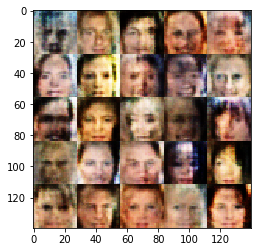

Epoch 1/1... Discriminator Loss: 1.4629... Generator Loss: 1.8686


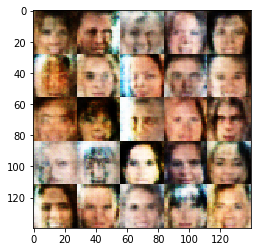

Epoch 1/1... Discriminator Loss: 1.0970... Generator Loss: 1.0958


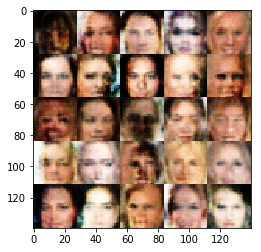

Epoch 1/1... Discriminator Loss: 0.9622... Generator Loss: 1.0821


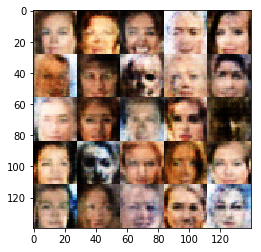

Epoch 1/1... Discriminator Loss: 0.8517... Generator Loss: 1.4642


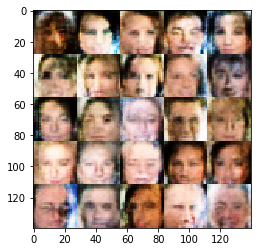

Epoch 1/1... Discriminator Loss: 1.4265... Generator Loss: 2.2744


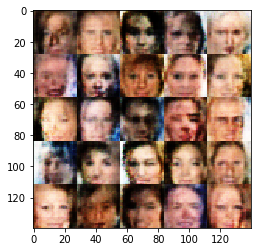

Epoch 1/1... Discriminator Loss: 1.1051... Generator Loss: 0.9387


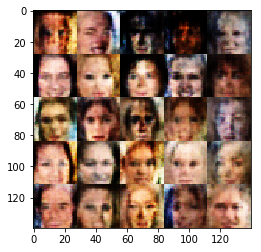

Epoch 1/1... Discriminator Loss: 1.5435... Generator Loss: 2.3601


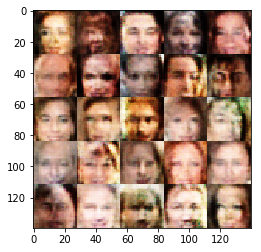

Epoch 1/1... Discriminator Loss: 1.0154... Generator Loss: 1.6584


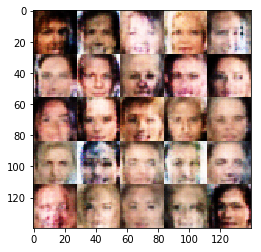

Epoch 1/1... Discriminator Loss: 1.1282... Generator Loss: 1.7528


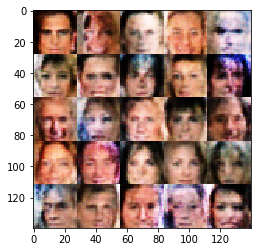

Epoch 1/1... Discriminator Loss: 1.1690... Generator Loss: 1.0787


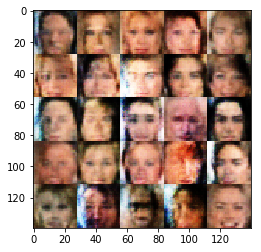

Epoch 1/1... Discriminator Loss: 1.3790... Generator Loss: 0.5385


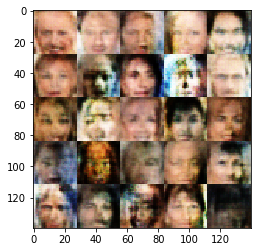

Epoch 1/1... Discriminator Loss: 1.3401... Generator Loss: 1.9073


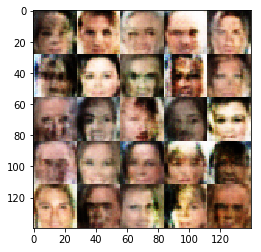

Epoch 1/1... Discriminator Loss: 1.1748... Generator Loss: 0.7401


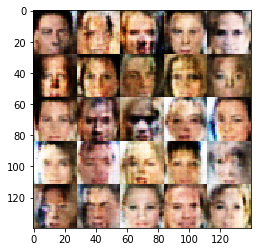

Epoch 1/1... Discriminator Loss: 0.9138... Generator Loss: 1.0882


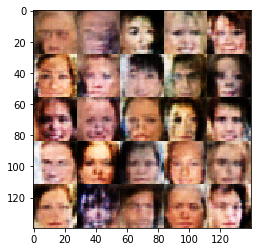

Epoch 1/1... Discriminator Loss: 1.2281... Generator Loss: 0.6422


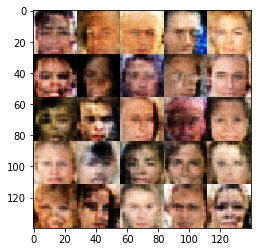

Epoch 1/1... Discriminator Loss: 1.2360... Generator Loss: 0.6599


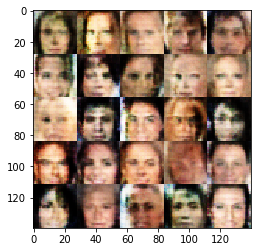

Epoch 1/1... Discriminator Loss: 0.8968... Generator Loss: 1.2192


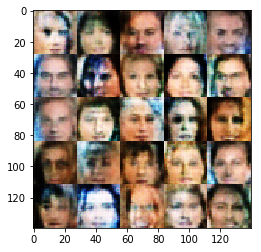

Epoch 1/1... Discriminator Loss: 1.2480... Generator Loss: 0.7835


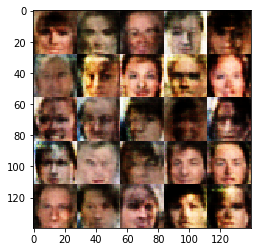

Epoch 1/1... Discriminator Loss: 1.2456... Generator Loss: 1.9010


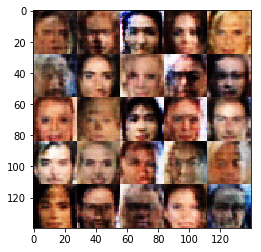

Epoch 1/1... Discriminator Loss: 1.1749... Generator Loss: 0.7786


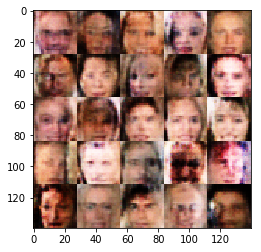

Epoch 1/1... Discriminator Loss: 1.1092... Generator Loss: 0.7664


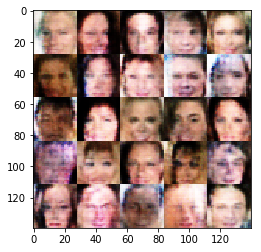

Epoch 1/1... Discriminator Loss: 0.9520... Generator Loss: 1.2132


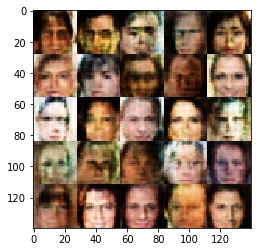

Epoch 1/1... Discriminator Loss: 0.9460... Generator Loss: 1.4191


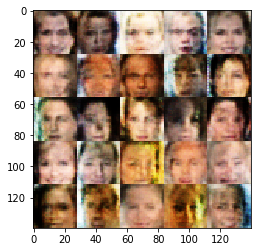

Epoch 1/1... Discriminator Loss: 0.8935... Generator Loss: 1.5114


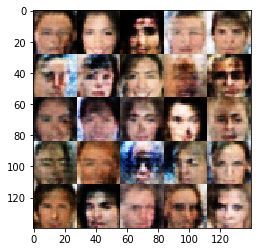

Epoch 1/1... Discriminator Loss: 1.0544... Generator Loss: 0.9725


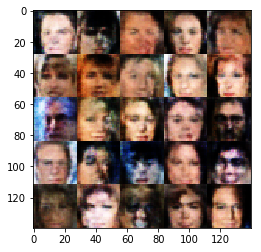

Epoch 1/1... Discriminator Loss: 1.2332... Generator Loss: 0.8806


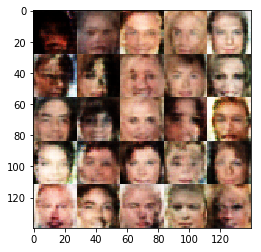

Epoch 1/1... Discriminator Loss: 1.5075... Generator Loss: 0.4627


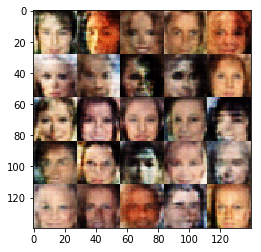

Epoch 1/1... Discriminator Loss: 0.8929... Generator Loss: 1.3376


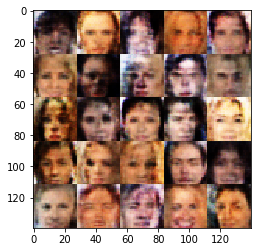

Epoch 1/1... Discriminator Loss: 1.2064... Generator Loss: 1.6041


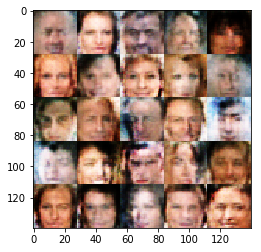

Epoch 1/1... Discriminator Loss: 1.2370... Generator Loss: 0.7042


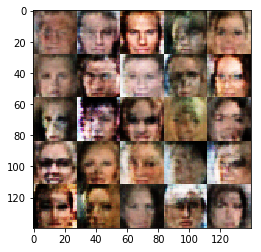

Epoch 1/1... Discriminator Loss: 1.1424... Generator Loss: 0.7872


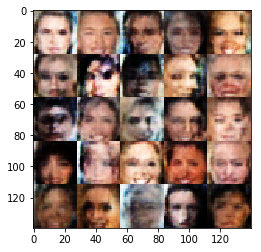

Epoch 1/1... Discriminator Loss: 2.5814... Generator Loss: 3.6299


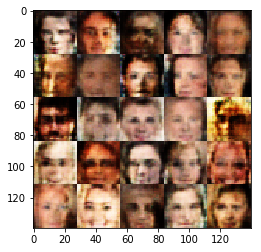

Epoch 1/1... Discriminator Loss: 1.5152... Generator Loss: 0.4692


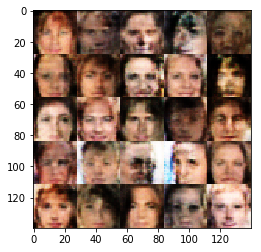

Epoch 1/1... Discriminator Loss: 1.2669... Generator Loss: 0.7009


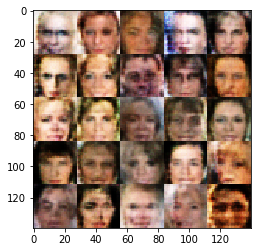

Epoch 1/1... Discriminator Loss: 1.0145... Generator Loss: 1.3519


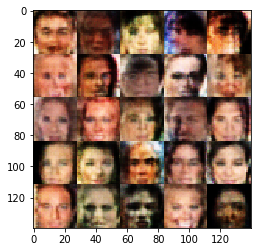

Epoch 1/1... Discriminator Loss: 1.0949... Generator Loss: 1.4946


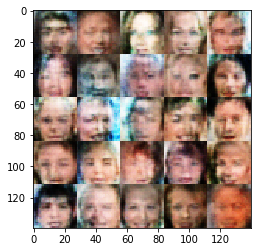

Epoch 1/1... Discriminator Loss: 1.0737... Generator Loss: 0.9330


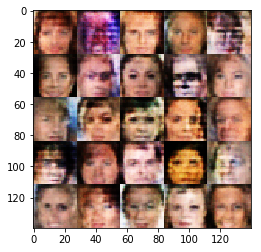

Epoch 1/1... Discriminator Loss: 1.1698... Generator Loss: 0.8308


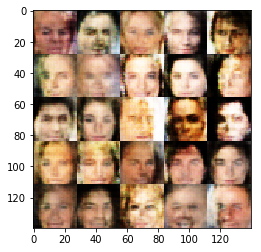

Epoch 1/1... Discriminator Loss: 0.8311... Generator Loss: 1.8877


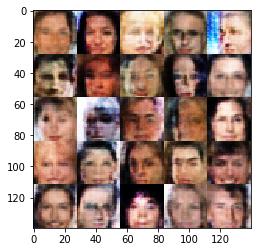

Epoch 1/1... Discriminator Loss: 1.0810... Generator Loss: 0.9534


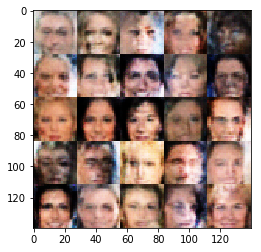

Epoch 1/1... Discriminator Loss: 1.0474... Generator Loss: 1.0239


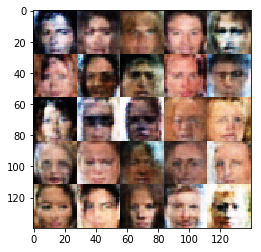

Epoch 1/1... Discriminator Loss: 1.2353... Generator Loss: 0.6439


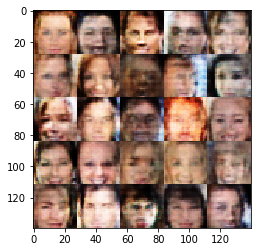

Epoch 1/1... Discriminator Loss: 1.0726... Generator Loss: 1.5813


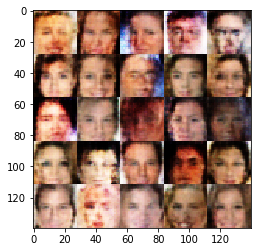

Epoch 1/1... Discriminator Loss: 1.0603... Generator Loss: 0.8638


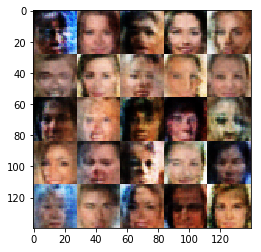

Epoch 1/1... Discriminator Loss: 1.4243... Generator Loss: 0.5174


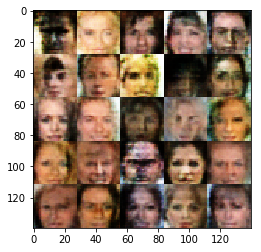

Epoch 1/1... Discriminator Loss: 0.9714... Generator Loss: 1.1490


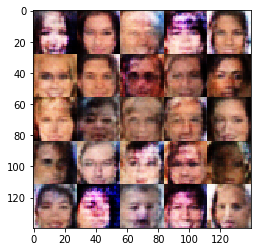

Epoch 1/1... Discriminator Loss: 1.2057... Generator Loss: 1.6759


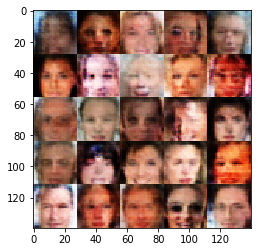

Epoch 1/1... Discriminator Loss: 1.2201... Generator Loss: 2.0115


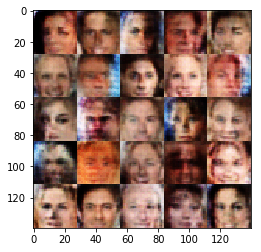

Epoch 1/1... Discriminator Loss: 0.9398... Generator Loss: 1.3241


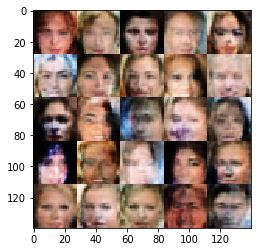

Epoch 1/1... Discriminator Loss: 0.9817... Generator Loss: 1.0196


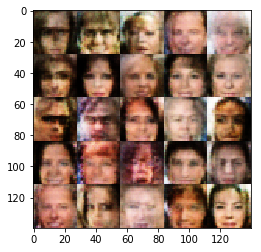

Epoch 1/1... Discriminator Loss: 1.0792... Generator Loss: 1.0673


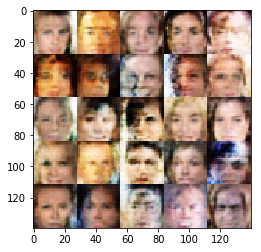

Epoch 1/1... Discriminator Loss: 0.9877... Generator Loss: 1.0888


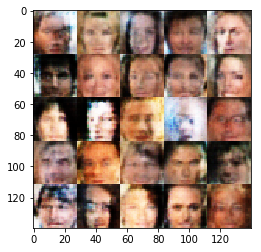

Epoch 1/1... Discriminator Loss: 1.0432... Generator Loss: 1.1569


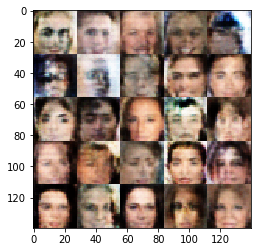

Epoch 1/1... Discriminator Loss: 1.1579... Generator Loss: 0.7237


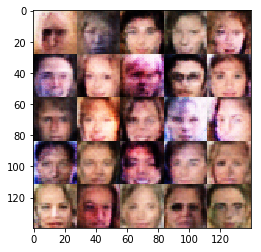

Epoch 1/1... Discriminator Loss: 2.4474... Generator Loss: 4.7296


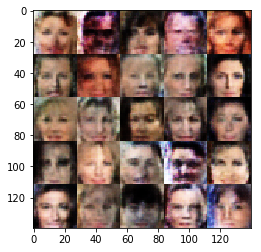

Epoch 1/1... Discriminator Loss: 1.3179... Generator Loss: 0.6303


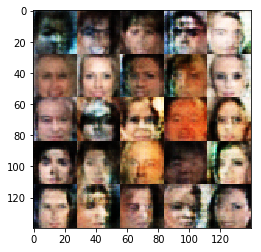

Epoch 1/1... Discriminator Loss: 1.1893... Generator Loss: 0.9440


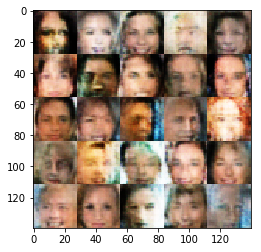

Epoch 1/1... Discriminator Loss: 1.3634... Generator Loss: 0.6289


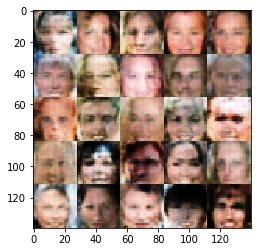

Epoch 1/1... Discriminator Loss: 0.9875... Generator Loss: 1.0836


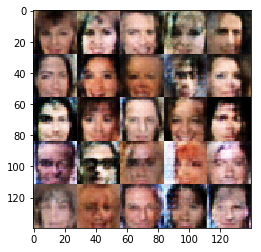

Epoch 1/1... Discriminator Loss: 1.5008... Generator Loss: 0.4643


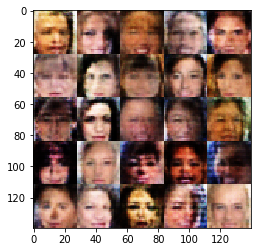

Epoch 1/1... Discriminator Loss: 1.2163... Generator Loss: 0.7061


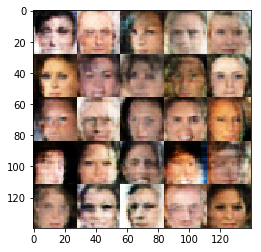

Epoch 1/1... Discriminator Loss: 1.4354... Generator Loss: 0.5276


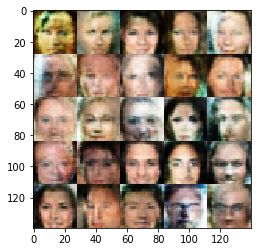

Epoch 1/1... Discriminator Loss: 1.2563... Generator Loss: 0.7181


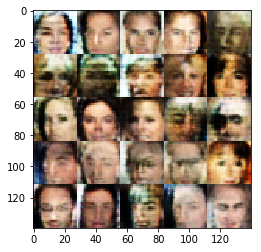

Epoch 1/1... Discriminator Loss: 1.1434... Generator Loss: 0.8191


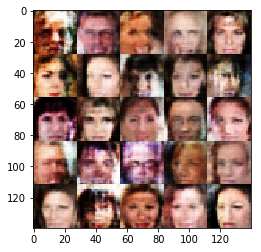

Epoch 1/1... Discriminator Loss: 0.9811... Generator Loss: 1.0450


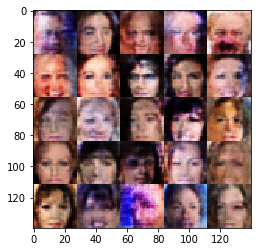

Epoch 1/1... Discriminator Loss: 0.9294... Generator Loss: 1.6585


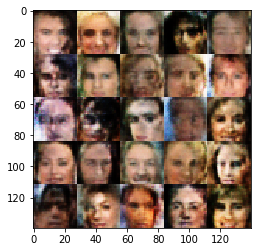

Epoch 1/1... Discriminator Loss: 0.9899... Generator Loss: 1.9251


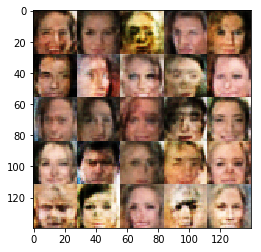

Epoch 1/1... Discriminator Loss: 1.5136... Generator Loss: 2.7710


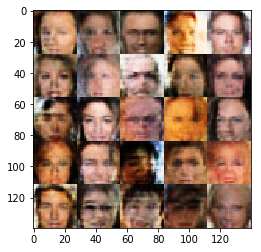

Epoch 1/1... Discriminator Loss: 1.2278... Generator Loss: 0.7624


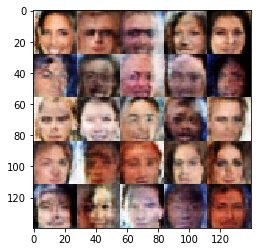

Epoch 1/1... Discriminator Loss: 0.8735... Generator Loss: 1.3972


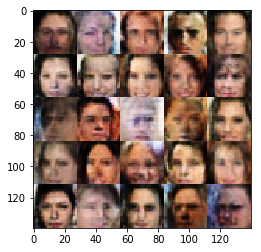

Epoch 1/1... Discriminator Loss: 0.9444... Generator Loss: 1.0874


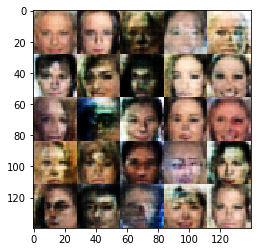

Epoch 1/1... Discriminator Loss: 1.7903... Generator Loss: 0.3998


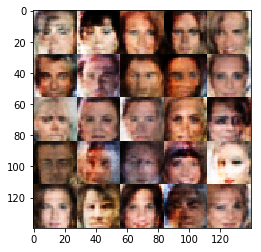

Epoch 1/1... Discriminator Loss: 0.9718... Generator Loss: 1.2015


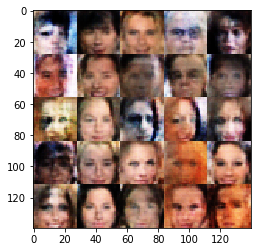

Epoch 1/1... Discriminator Loss: 1.2151... Generator Loss: 0.7654


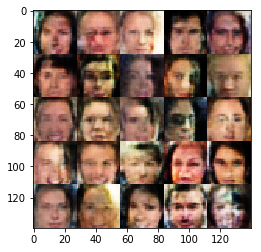

Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 1.1544


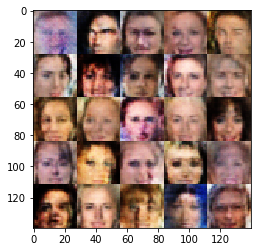

Epoch 1/1... Discriminator Loss: 0.9637... Generator Loss: 1.3843


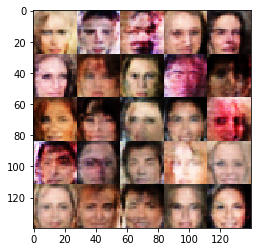

Epoch 1/1... Discriminator Loss: 1.4437... Generator Loss: 0.4871


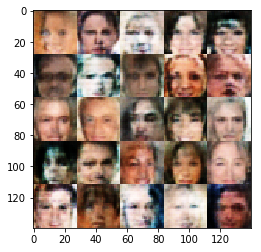

Epoch 1/1... Discriminator Loss: 1.0950... Generator Loss: 2.3161


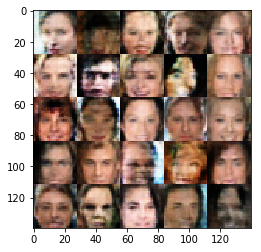

Epoch 1/1... Discriminator Loss: 1.9109... Generator Loss: 0.3428


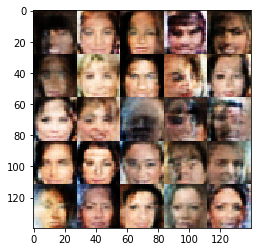

Epoch 1/1... Discriminator Loss: 1.2057... Generator Loss: 1.2745


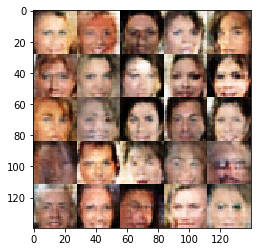

Epoch 1/1... Discriminator Loss: 1.3956... Generator Loss: 0.5956


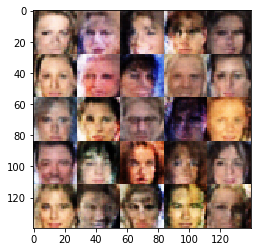

Epoch 1/1... Discriminator Loss: 1.0638... Generator Loss: 1.0107


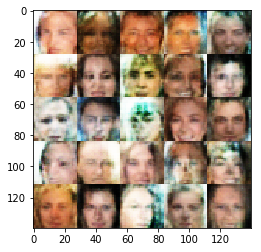

Epoch 1/1... Discriminator Loss: 1.1172... Generator Loss: 1.3021


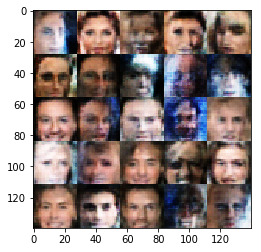

Epoch 1/1... Discriminator Loss: 1.0449... Generator Loss: 0.8174


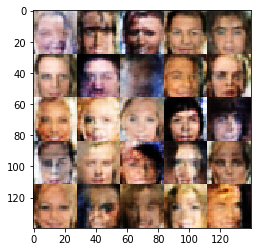

Epoch 1/1... Discriminator Loss: 1.5696... Generator Loss: 0.8628


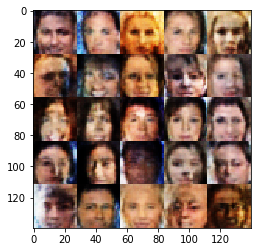

Epoch 1/1... Discriminator Loss: 1.0286... Generator Loss: 1.2710


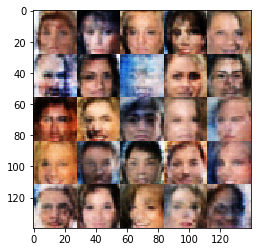

Epoch 1/1... Discriminator Loss: 1.1001... Generator Loss: 0.9567


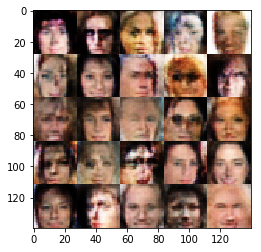

Epoch 1/1... Discriminator Loss: 1.5084... Generator Loss: 0.4194


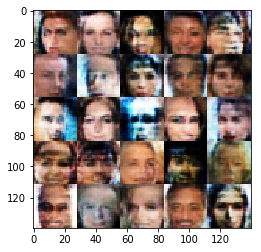

Epoch 1/1... Discriminator Loss: 0.6474... Generator Loss: 2.0328


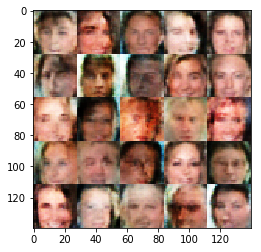

Epoch 1/1... Discriminator Loss: 0.7494... Generator Loss: 1.6471


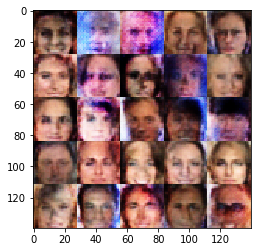

Epoch 1/1... Discriminator Loss: 1.0735... Generator Loss: 0.8587


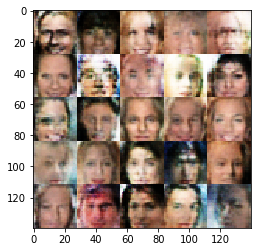

Epoch 1/1... Discriminator Loss: 1.5427... Generator Loss: 0.5146


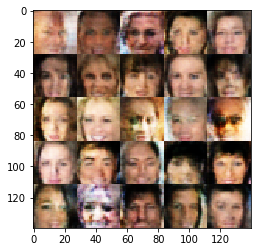

Epoch 1/1... Discriminator Loss: 1.8029... Generator Loss: 4.3640


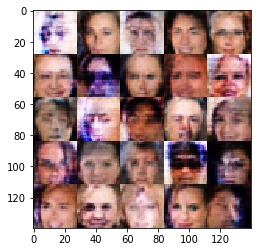

Epoch 1/1... Discriminator Loss: 0.9354... Generator Loss: 1.0825


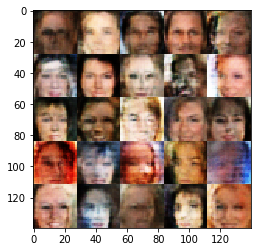

Epoch 1/1... Discriminator Loss: 1.3018... Generator Loss: 0.6281


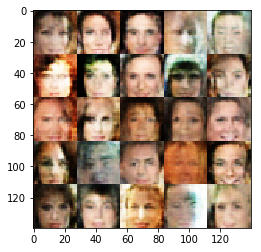

Epoch 1/1... Discriminator Loss: 1.4540... Generator Loss: 0.5476


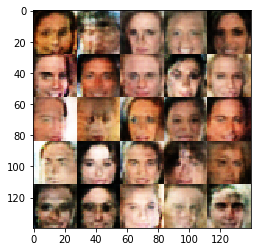

Epoch 1/1... Discriminator Loss: 0.9023... Generator Loss: 1.0380


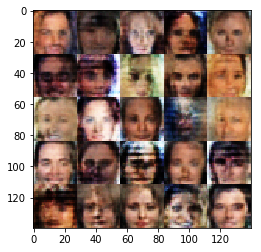

Epoch 1/1... Discriminator Loss: 1.0338... Generator Loss: 2.1328


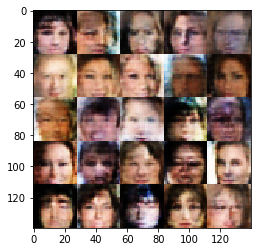

Epoch 1/1... Discriminator Loss: 1.6105... Generator Loss: 0.4261


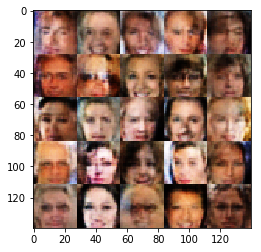

Epoch 1/1... Discriminator Loss: 0.9739... Generator Loss: 1.7485


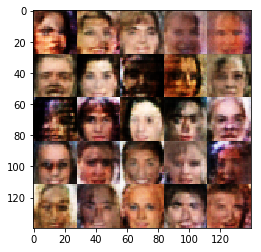

Epoch 1/1... Discriminator Loss: 0.9093... Generator Loss: 1.1916


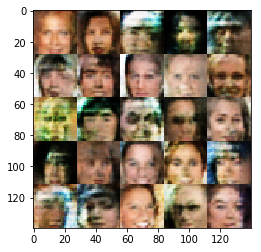

Epoch 1/1... Discriminator Loss: 1.1110... Generator Loss: 0.7447


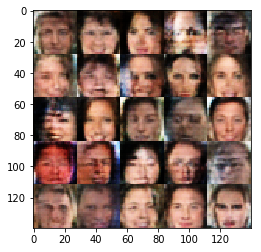

Epoch 1/1... Discriminator Loss: 2.3067... Generator Loss: 0.1997


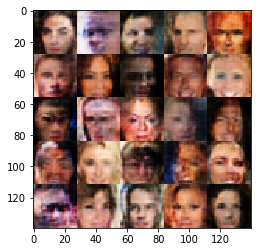

Epoch 1/1... Discriminator Loss: 1.2730... Generator Loss: 0.6950


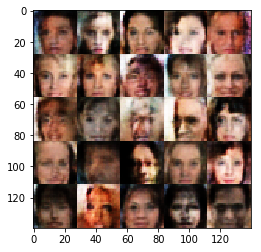

Epoch 1/1... Discriminator Loss: 0.9808... Generator Loss: 1.4875


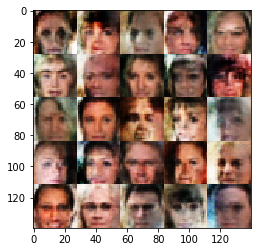

Epoch 1/1... Discriminator Loss: 1.0248... Generator Loss: 1.0797


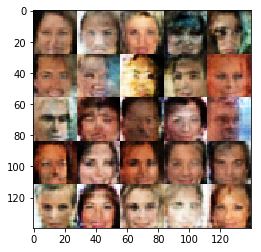

Epoch 1/1... Discriminator Loss: 1.5991... Generator Loss: 2.4887


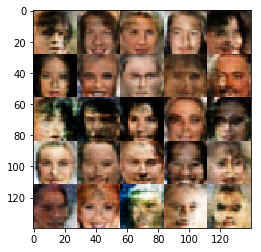

Epoch 1/1... Discriminator Loss: 1.1830... Generator Loss: 2.3109


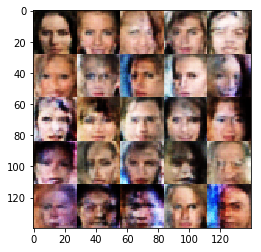

Epoch 1/1... Discriminator Loss: 1.7871... Generator Loss: 4.1204


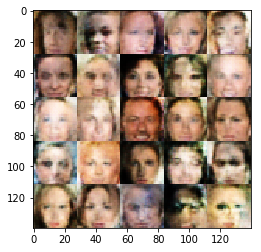

Epoch 1/1... Discriminator Loss: 1.0481... Generator Loss: 0.8575


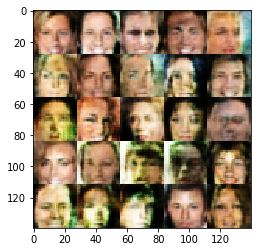

Epoch 1/1... Discriminator Loss: 1.2365... Generator Loss: 0.6362


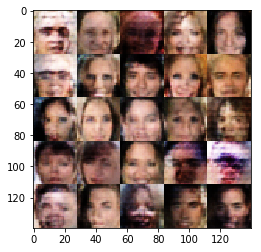

Epoch 1/1... Discriminator Loss: 1.3921... Generator Loss: 0.6213


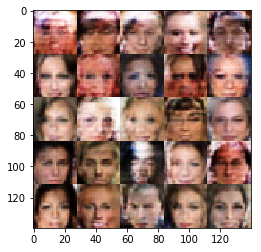

Epoch 1/1... Discriminator Loss: 1.2510... Generator Loss: 3.2686


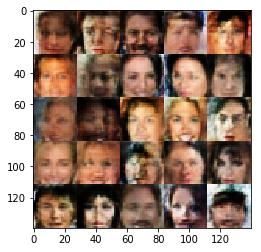

Epoch 1/1... Discriminator Loss: 0.9590... Generator Loss: 1.4167


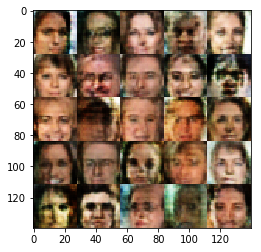

Epoch 1/1... Discriminator Loss: 1.0446... Generator Loss: 1.0133


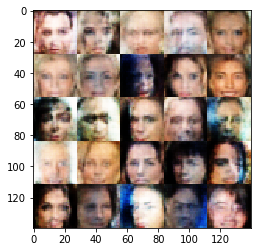

Epoch 1/1... Discriminator Loss: 1.0147... Generator Loss: 1.5842


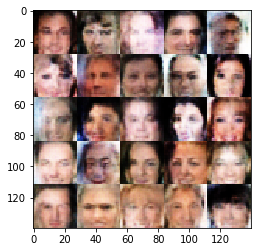

Epoch 1/1... Discriminator Loss: 0.8908... Generator Loss: 2.7468


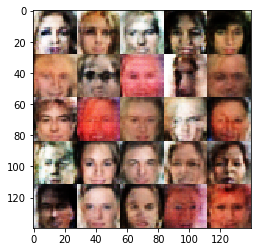

Epoch 1/1... Discriminator Loss: 1.1095... Generator Loss: 0.8518


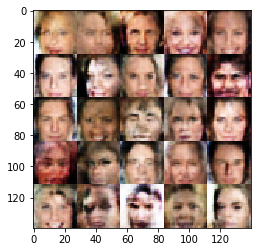

Epoch 1/1... Discriminator Loss: 0.8017... Generator Loss: 1.4000


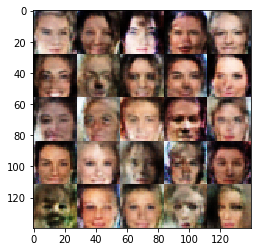

Epoch 1/1... Discriminator Loss: 0.8773... Generator Loss: 1.3215


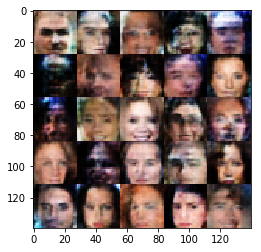

Epoch 1/1... Discriminator Loss: 1.2789... Generator Loss: 0.7077


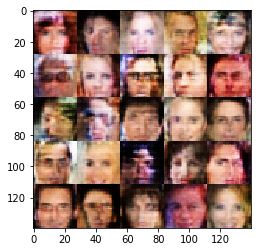

Epoch 1/1... Discriminator Loss: 0.8457... Generator Loss: 1.9636


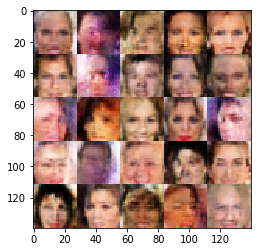

Epoch 1/1... Discriminator Loss: 1.1840... Generator Loss: 1.8008


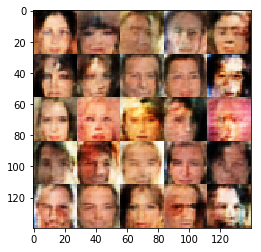

Epoch 1/1... Discriminator Loss: 1.5151... Generator Loss: 2.9292


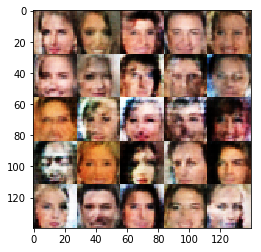

Epoch 1/1... Discriminator Loss: 0.9009... Generator Loss: 1.8177


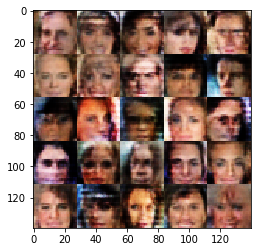

Epoch 1/1... Discriminator Loss: 1.1488... Generator Loss: 0.7460


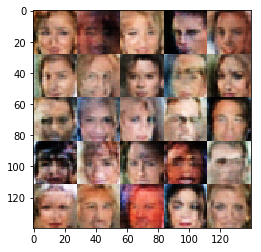

Epoch 1/1... Discriminator Loss: 1.0437... Generator Loss: 0.9775


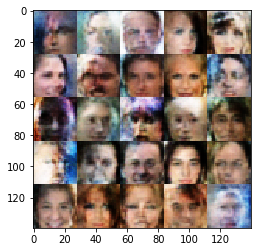

Epoch 1/1... Discriminator Loss: 0.8982... Generator Loss: 1.6459


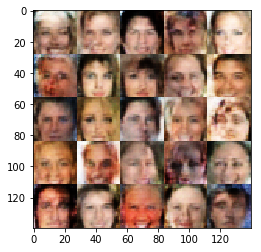

Epoch 1/1... Discriminator Loss: 1.3181... Generator Loss: 2.4318


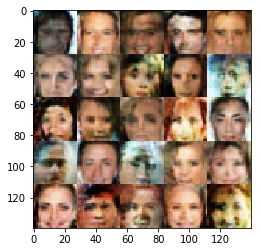

Epoch 1/1... Discriminator Loss: 1.8038... Generator Loss: 0.3485


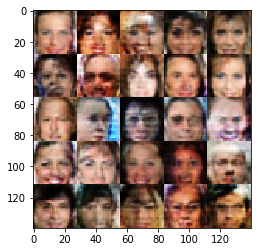

Epoch 1/1... Discriminator Loss: 1.9391... Generator Loss: 0.3472


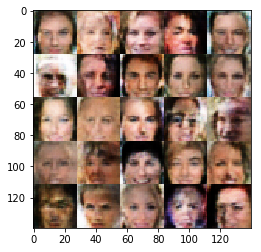

Epoch 1/1... Discriminator Loss: 0.8868... Generator Loss: 1.8005


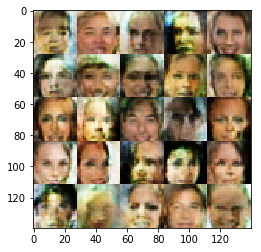

Epoch 1/1... Discriminator Loss: 1.1613... Generator Loss: 0.7393


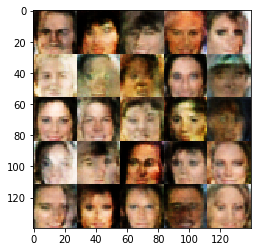

Epoch 1/1... Discriminator Loss: 2.0103... Generator Loss: 0.3015


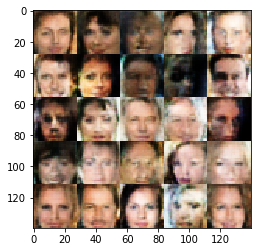

Epoch 1/1... Discriminator Loss: 0.9184... Generator Loss: 2.1605


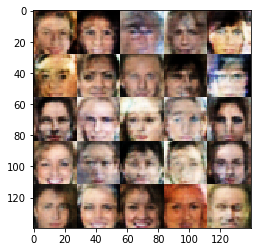

Epoch 1/1... Discriminator Loss: 0.9932... Generator Loss: 0.9388


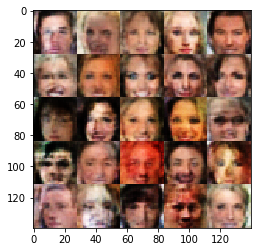

Epoch 1/1... Discriminator Loss: 0.7810... Generator Loss: 1.2903


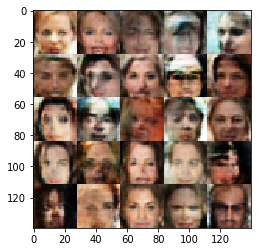

Epoch 1/1... Discriminator Loss: 0.9515... Generator Loss: 0.9799


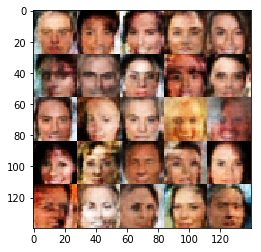

Epoch 1/1... Discriminator Loss: 1.0425... Generator Loss: 3.0237


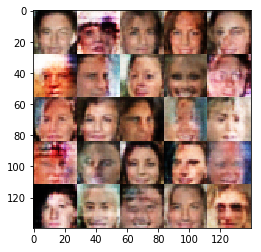

Epoch 1/1... Discriminator Loss: 0.6723... Generator Loss: 1.8633


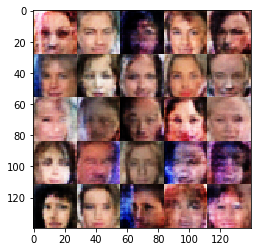

Epoch 1/1... Discriminator Loss: 1.0094... Generator Loss: 0.9303


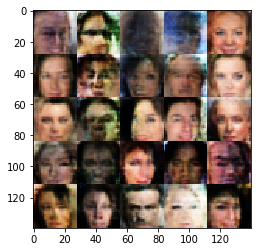

Epoch 1/1... Discriminator Loss: 0.8824... Generator Loss: 1.2293


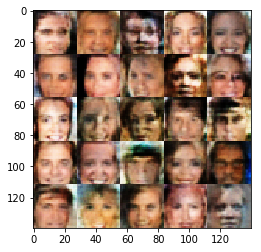

Epoch 1/1... Discriminator Loss: 0.9797... Generator Loss: 1.0491


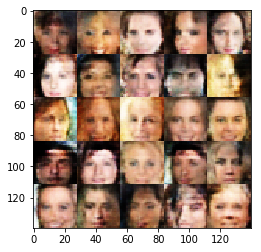

Epoch 1/1... Discriminator Loss: 1.5327... Generator Loss: 0.5140


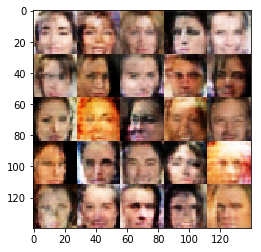

Epoch 1/1... Discriminator Loss: 1.0050... Generator Loss: 1.1740


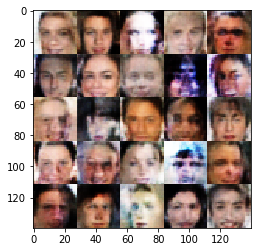

Epoch 1/1... Discriminator Loss: 0.9183... Generator Loss: 1.0200


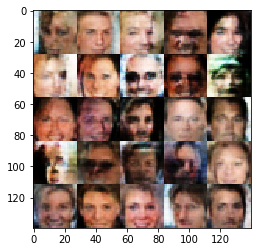

Epoch 1/1... Discriminator Loss: 1.0106... Generator Loss: 0.9774


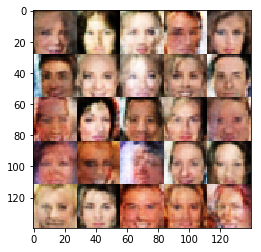

Epoch 1/1... Discriminator Loss: 1.2802... Generator Loss: 0.6611


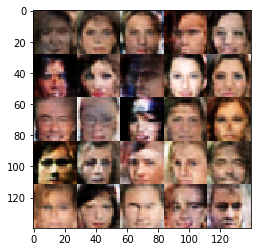

Epoch 1/1... Discriminator Loss: 1.1830... Generator Loss: 0.7521


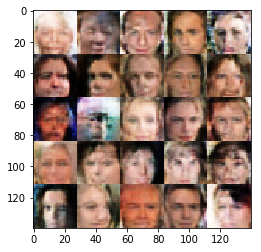

Epoch 1/1... Discriminator Loss: 1.5537... Generator Loss: 0.4972


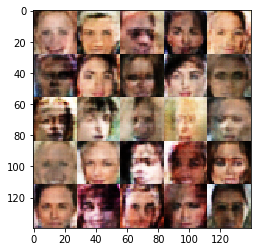

Epoch 1/1... Discriminator Loss: 0.6909... Generator Loss: 2.0630


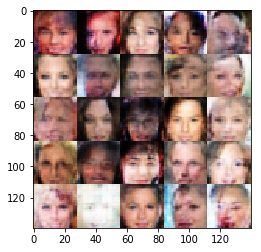

Epoch 1/1... Discriminator Loss: 0.6869... Generator Loss: 1.6397


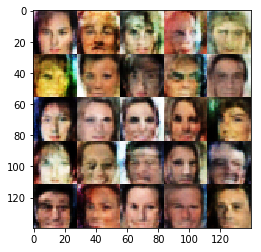

Epoch 1/1... Discriminator Loss: 1.2382... Generator Loss: 0.7094


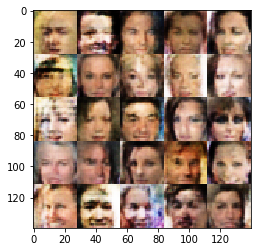

Epoch 1/1... Discriminator Loss: 0.7861... Generator Loss: 1.4709


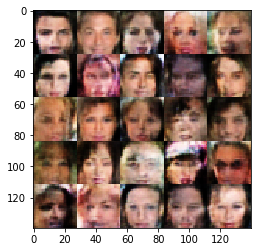

Epoch 1/1... Discriminator Loss: 1.4091... Generator Loss: 0.5689


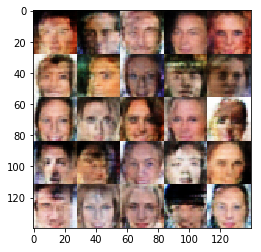

Epoch 1/1... Discriminator Loss: 0.8664... Generator Loss: 1.3525


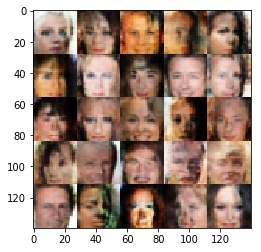

Epoch 1/1... Discriminator Loss: 1.9671... Generator Loss: 0.2884


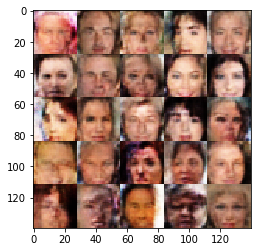

Epoch 1/1... Discriminator Loss: 0.7857... Generator Loss: 1.7847


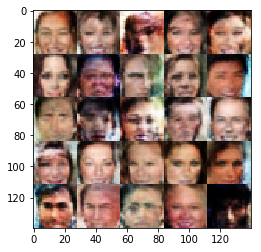

Epoch 1/1... Discriminator Loss: 0.5901... Generator Loss: 2.0343


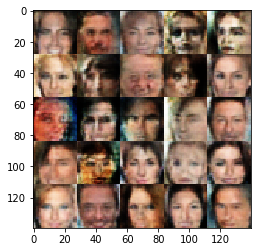

Epoch 1/1... Discriminator Loss: 1.0465... Generator Loss: 0.8406


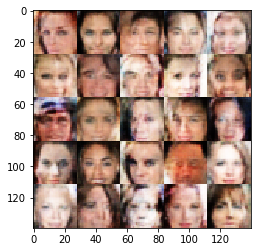

Epoch 1/1... Discriminator Loss: 0.6608... Generator Loss: 1.6113


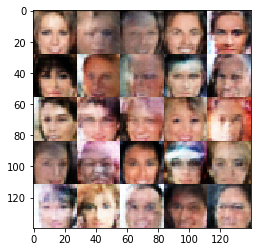

Epoch 1/1... Discriminator Loss: 0.9273... Generator Loss: 2.4315


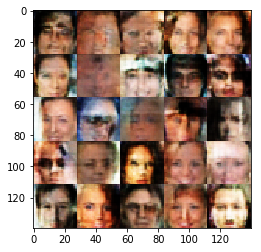

Epoch 1/1... Discriminator Loss: 1.0432... Generator Loss: 0.8687


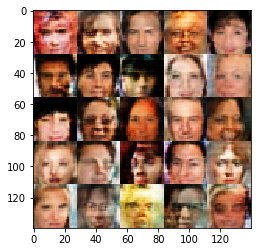

Epoch 1/1... Discriminator Loss: 0.9161... Generator Loss: 1.1582


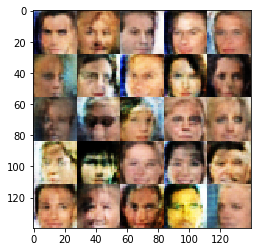

Epoch 1/1... Discriminator Loss: 1.5346... Generator Loss: 0.5069


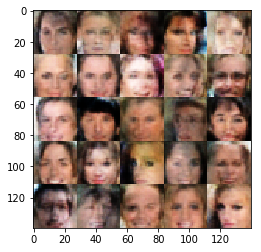

Epoch 1/1... Discriminator Loss: 1.6779... Generator Loss: 0.3841


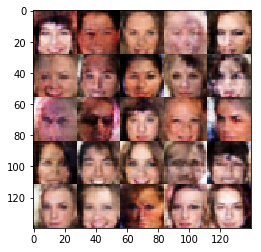

Epoch 1/1... Discriminator Loss: 0.8797... Generator Loss: 1.2213


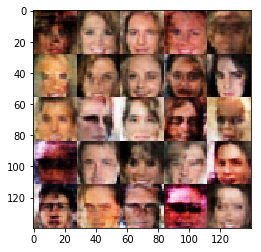

Epoch 1/1... Discriminator Loss: 0.9414... Generator Loss: 2.0677


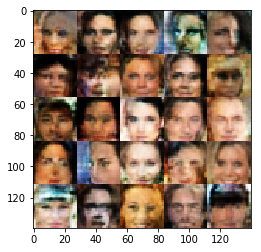

Epoch 1/1... Discriminator Loss: 0.9790... Generator Loss: 1.0212


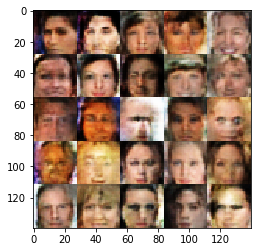

Epoch 1/1... Discriminator Loss: 0.7168... Generator Loss: 2.2149


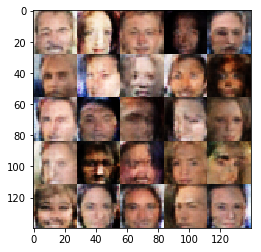

Epoch 1/1... Discriminator Loss: 0.8299... Generator Loss: 1.7314


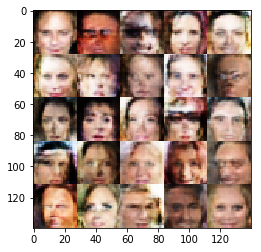

Epoch 1/1... Discriminator Loss: 2.4179... Generator Loss: 0.1875


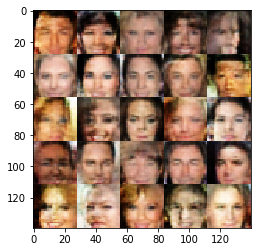

Epoch 1/1... Discriminator Loss: 0.8184... Generator Loss: 1.2086


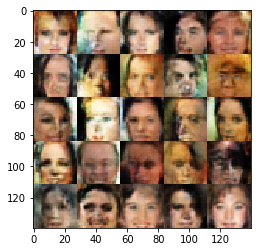

Epoch 1/1... Discriminator Loss: 1.9509... Generator Loss: 0.3232


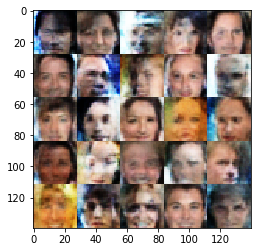

Epoch 1/1... Discriminator Loss: 0.8400... Generator Loss: 1.1633


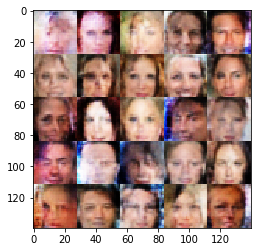

Epoch 1/1... Discriminator Loss: 0.9000... Generator Loss: 3.6686


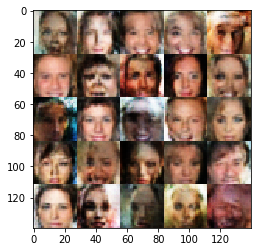

Epoch 1/1... Discriminator Loss: 1.1099... Generator Loss: 0.8188


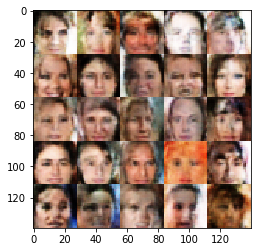

Epoch 1/1... Discriminator Loss: 0.6942... Generator Loss: 2.3091


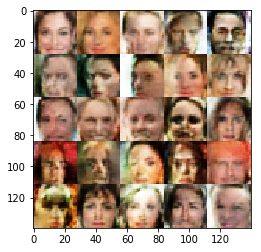

Epoch 1/1... Discriminator Loss: 1.2391... Generator Loss: 0.6669


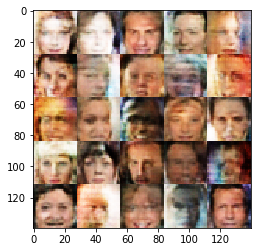

Epoch 1/1... Discriminator Loss: 2.5403... Generator Loss: 0.1796


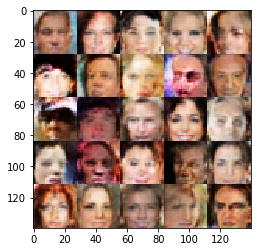

Epoch 1/1... Discriminator Loss: 0.7980... Generator Loss: 2.5957


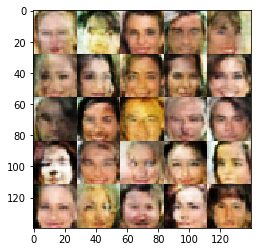

Epoch 1/1... Discriminator Loss: 0.9170... Generator Loss: 1.4086


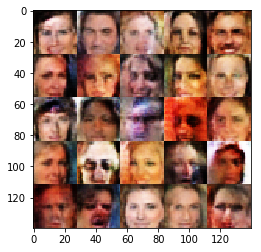

Epoch 1/1... Discriminator Loss: 0.6656... Generator Loss: 1.6194


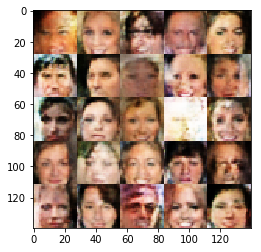

Epoch 1/1... Discriminator Loss: 1.4998... Generator Loss: 0.4847


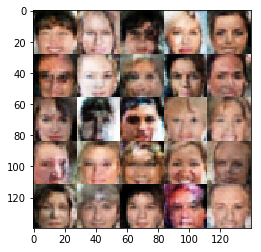

Epoch 1/1... Discriminator Loss: 1.7784... Generator Loss: 3.3899


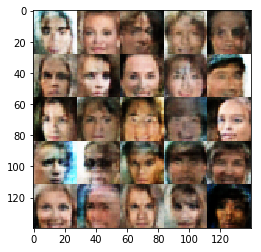

Epoch 1/1... Discriminator Loss: 0.7157... Generator Loss: 2.4416


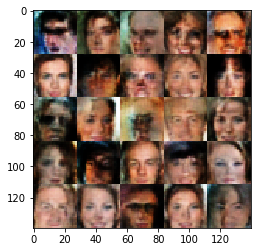

Epoch 1/1... Discriminator Loss: 1.7857... Generator Loss: 0.3836


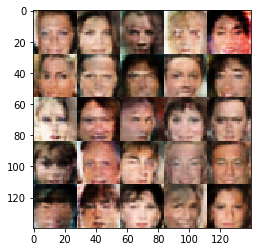

Epoch 1/1... Discriminator Loss: 0.8728... Generator Loss: 1.1161


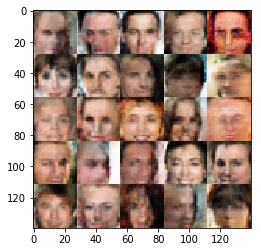

Epoch 1/1... Discriminator Loss: 0.7191... Generator Loss: 1.7407


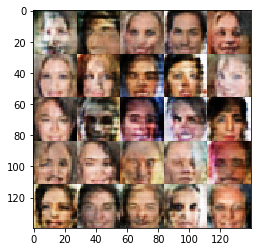

Epoch 1/1... Discriminator Loss: 1.2359... Generator Loss: 0.6728


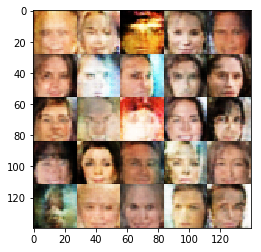

Epoch 1/1... Discriminator Loss: 1.4411... Generator Loss: 3.2433


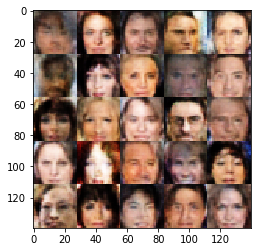

Epoch 1/1... Discriminator Loss: 0.7181... Generator Loss: 1.5420


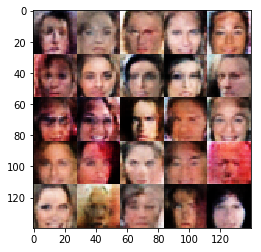

Epoch 1/1... Discriminator Loss: 0.7805... Generator Loss: 1.4801


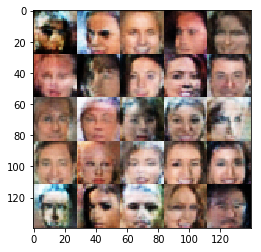

Epoch 1/1... Discriminator Loss: 0.7280... Generator Loss: 1.6892


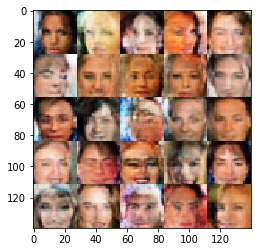

Epoch 1/1... Discriminator Loss: 0.5803... Generator Loss: 1.7924


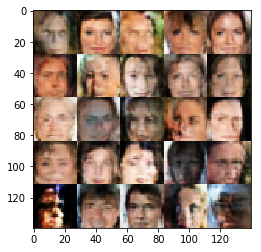

Epoch 1/1... Discriminator Loss: 1.4233... Generator Loss: 0.6069


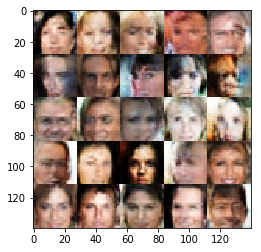

Epoch 1/1... Discriminator Loss: 1.1207... Generator Loss: 0.8038


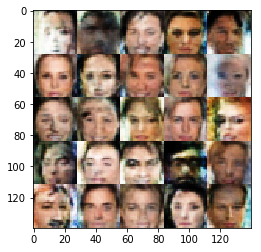

Epoch 1/1... Discriminator Loss: 1.0252... Generator Loss: 0.8334


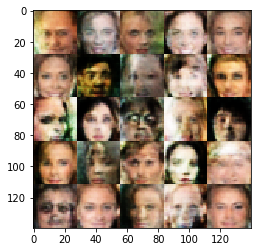

Epoch 1/1... Discriminator Loss: 0.6824... Generator Loss: 3.1336


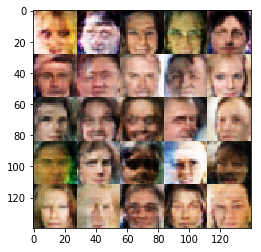

Epoch 1/1... Discriminator Loss: 0.8330... Generator Loss: 1.2374


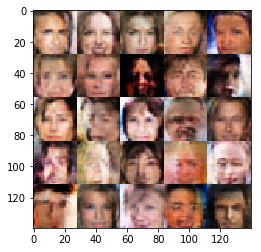

Epoch 1/1... Discriminator Loss: 0.9910... Generator Loss: 0.9805


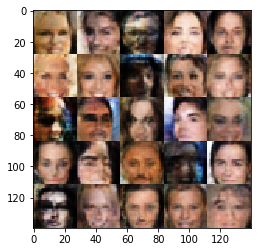

Epoch 1/1... Discriminator Loss: 0.8462... Generator Loss: 1.2380


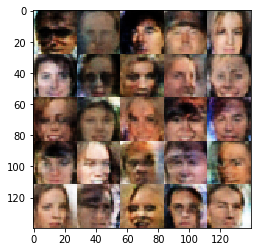

Epoch 1/1... Discriminator Loss: 1.2349... Generator Loss: 4.5403


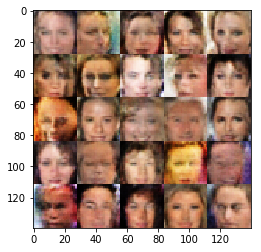

Epoch 1/1... Discriminator Loss: 0.7361... Generator Loss: 1.3962


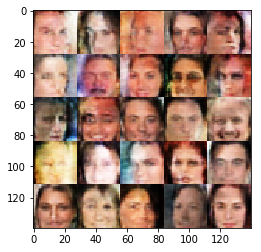

Epoch 1/1... Discriminator Loss: 0.4740... Generator Loss: 2.7663


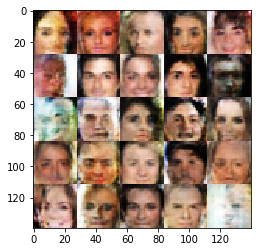

Epoch 1/1... Discriminator Loss: 0.5988... Generator Loss: 1.7915


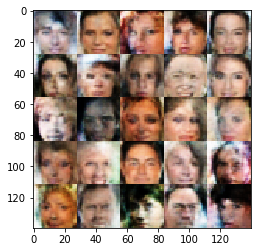

Epoch 1/1... Discriminator Loss: 2.4292... Generator Loss: 0.2465


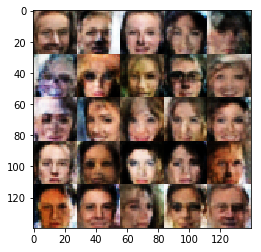

Epoch 1/1... Discriminator Loss: 0.7065... Generator Loss: 2.1466


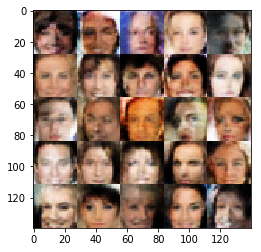

Epoch 1/1... Discriminator Loss: 0.5783... Generator Loss: 1.9396


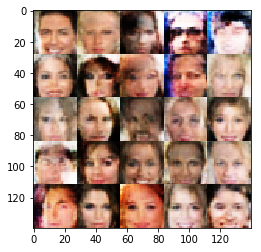

Epoch 1/1... Discriminator Loss: 0.9235... Generator Loss: 1.1145


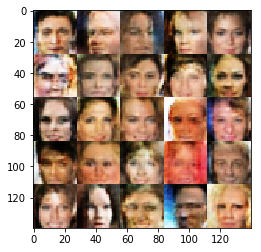

Epoch 1/1... Discriminator Loss: 0.6549... Generator Loss: 1.8156


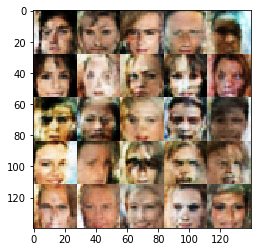

Epoch 1/1... Discriminator Loss: 0.7661... Generator Loss: 2.1149


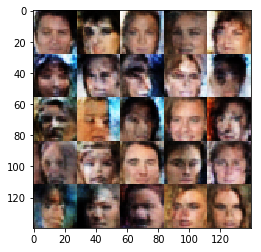

Epoch 1/1... Discriminator Loss: 1.4003... Generator Loss: 0.5990


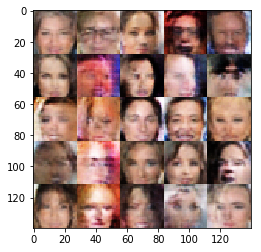

Epoch 1/1... Discriminator Loss: 0.9739... Generator Loss: 1.9034


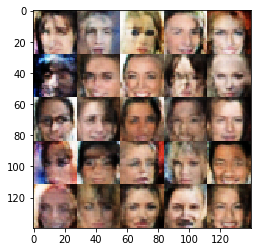

Epoch 1/1... Discriminator Loss: 0.7297... Generator Loss: 2.1883


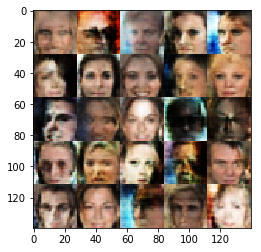

Epoch 1/1... Discriminator Loss: 0.6196... Generator Loss: 2.0657


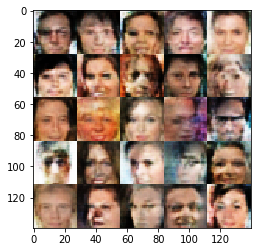

Epoch 1/1... Discriminator Loss: 0.8008... Generator Loss: 1.6680


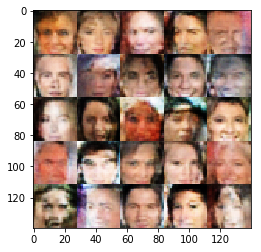

Epoch 1/1... Discriminator Loss: 1.2364... Generator Loss: 0.7176


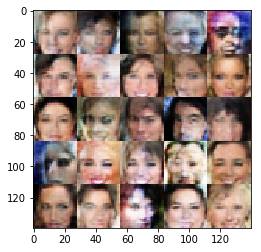

Epoch 1/1... Discriminator Loss: 0.5735... Generator Loss: 1.9072


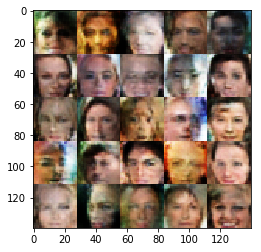

Epoch 1/1... Discriminator Loss: 0.6758... Generator Loss: 1.6318


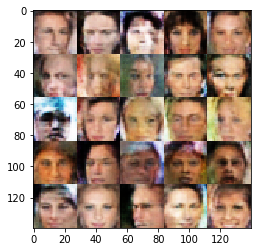

In [13]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.